<a href="https://colab.research.google.com/github/arodriguez2222/inmersion_datos_alura/blob/main/inmersion_datos_alura.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Bienvenido a nuestro primer encuentro de inmersión de datos.

## Seccion 1

Se realiza un exploratorio inicial de la información relacionada con inmuebles.

In [138]:
#Se importan las librerias
import pandas as pd
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import data_table
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, r2_score

data_table.enable_dataframe_formatter()

In [2]:
#data_table.disable_dataframe_formatter() #deshabilita una mejora visual y de trabajo en las tablas de colab

In [3]:
#ajustes de pandas para mostrar solos 2 decimales en los datos float
pd.set_option('display.precision',2)
pd.set_option('display.float_format', lambda x: '%.2f' % x)

In [4]:
#Se importa el archivo con los datos a revisar
inmuebles = pd.read_csv("/content/drive/MyDrive/CURSOS Y DIPLOMAS/inmersion_datos/inmuebles_bogota.csv") 

In [5]:
inmuebles.head()

,Tipo,Descripcion,Habitaciones,Baños,Área,Barrio,UPZ,Valor
0,Apartamento,Apartamento en venta en Zona Noroccidental,3,2,70,Zona Noroccidental,CHAPINERO: Pardo Rubio + Chapinero,$ 360.000.000
1,Casa,Casa en venta en Castilla,4,3,170,Castilla,KENNEDY: Castilla + Bavaria,$ 670.000.000
2,Apartamento,Apartamento en venta en Chico Reservado,3,3,144,Chico Reservado,CHAPINERO: Chicó Lago + El Refugio,$ 1.120.000.000
3,Apartamento,Apartamento en venta en Usaquén,3,2,154,Usaquén,Usaquén,$ 890.000.000
4,Apartamento,Apartamento en venta en Bella Suiza,2,3,128,Bella Suiza,USAQUÉN: Country Club + Santa Bárbara,$ 970.000.000


In [6]:
#revisamos los valores unicos en barrios
print(inmuebles['Barrio'].unique(),
      'Los barrios unicos encontrados en el dataset fueron: ' + str(len(inmuebles['Barrio'].unique())),
      sep='\n')


['Zona Noroccidental' 'Castilla' 'Chico Reservado' 'Usaquén' 'Bella Suiza'
 'El Chicó' 'Tintala' 'Marly' 'Kennedy' 'Nicolas De Federman' 'La Calleja'
 'Mazuren' 'Suba' 'Barrios Unidos' 'Engativa' 'Fontibón' 'Villa Alsacia'
 'Palermo' 'La Candelaria' 'El Contador' 'El Batán' 'Santa Barbara'
 'Mirandela ' 'Cedritos' 'Colina Campestre' 'Hayuelos' 'Ciudad Salitre'
 'Quinta Paredes' 'Candelaria La Nueva' 'Chico Norte' 'Normandia'
 'Ciudad Bolívar' 'Bosa' 'Rafael Uribe Uribe' 'Las Villas' 'Modelia'
 'San Patricio' 'Barrancas' 'Teusaquillo' 'Puente Aranda' 'Chapinero'
 'Usme' 'Nueva Zelandia' 'Madelena' 'El Plan' 'Santa Paula' 'Villemar'
 'Santa Fe' 'Antonio Nariño' 'La Uribe' 'Los Rosales' 'Chapinero Central'
 'Los Mártires' 'Bogotá D.C' 'San Cristobal' 'Boyaca ' 'Timiza'
 'Gran America' 'Costa Azul' 'Gran Granada' 'La Salle'
 'Portales Del Norte' 'Cantagallo' 'Ciudad Berna' 'Villas De Granada'
 'Santa Teresa' 'Eduardo Santos' 'Pasadena ' 'Florida Blanca' 'Metropolis'
 'Galicia' 'Villa Maria

In [7]:
#revisamos la cantidad de filas y columnas que tiene el archivo importado
inmuebles.shape

(9520, 8)

In [8]:
#Se mira cuales son las columnas que tiene el dataframe
inmuebles.columns

Index(['Tipo', 'Descripcion', 'Habitaciones', 'Baños', 'Área', 'Barrio', 'UPZ',
       'Valor'],
      dtype='object')

Se realiza un rename de columnas, cambiando los nombres de las columnas Baños y Área por Banos y Area respectivamente. Esto para evitar futuros inconvenientes con la letra ñ y las tildes.

In [9]:
columnas = {'Baños':'Banos','Área':'Area'}
inmuebles.rename(columns=columnas,inplace = True)

In [10]:
#sample me permite tomar una muestra aleatoria de (x valor de registros) sobre el
#dataframe
inmuebles.sample(10)

,Tipo,Descripcion,Habitaciones,Banos,Area,Barrio,UPZ,Valor
5123,Casa,Casa en venta en Zona Noroccidental,4,5,481,Zona Noroccidental,CHAPINERO: Pardo Rubio + Chapinero,$ 2.800.000.000
4699,Apartamento,Apartamento en venta en Barrios Unidos,3,2,48,Barrios Unidos,Los Andes,$ 135.000.000
9407,Casa,Casa en venta en Bosa,7,3,252,Bosa,Bosa Central,$ 305.000.000
2427,Apartamento,Apartamento en venta en Antonio Nariño,4,3,162,Antonio Nariño,Restrepo,$ 390.000.000
2083,Casa,Casa en venta en Barrios Unidos,6,7,636,Barrios Unidos,Los Andes,$ 3.149.100.032
253,Apartamento,Apartamento en venta en Usaquén,3,2,71,Usaquén,Usaquén,$ 350.000.000
3217,Casa,Casa en venta en Cantagallo,4,3,69,Cantagallo,Britalia,$ 310.000.000
1757,Apartamento,Apartamento en venta en Ciudadela Colsubsidio,3,1,59,Ciudadela Colsubsidio,Bolivia,$ 175.000.000
2964,Apartamento,Apartamento en venta en Usaquén,3,2,61,Usaquén,Usaquén,$ 270.000.000
4350,Apartamento,Apartamento en venta en Zona Noroccidental,3,1,52,Zona Noroccidental,CHAPINERO: Pardo Rubio + Chapinero,$ 147.000.000


In [11]:
#con info() se revisa por columna si tenemos datos null, el tipo de datos y más información general
# util
inmuebles.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9520 entries, 0 to 9519
Data columns (total 8 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   Tipo          9520 non-null   object
 1   Descripcion   9520 non-null   object
 2   Habitaciones  9520 non-null   int64 
 3   Banos         9520 non-null   int64 
 4   Area          9520 non-null   int64 
 5   Barrio        9520 non-null   object
 6   UPZ           9478 non-null   object
 7   Valor         9520 non-null   object
dtypes: int64(3), object(5)
memory usage: 595.1+ KB


In [12]:
#probamos iloc, que basicamente me permite llamar partes de un dataframe seleccionando
# filas y columnas
inmuebles.iloc[3:11]

,Tipo,Descripcion,Habitaciones,Banos,Area,Barrio,UPZ,Valor
3,Apartamento,Apartamento en venta en Usaquén,3,2,154,Usaquén,Usaquén,$ 890.000.000
4,Apartamento,Apartamento en venta en Bella Suiza,2,3,128,Bella Suiza,USAQUÉN: Country Club + Santa Bárbara,$ 970.000.000
5,Apartamento,Apartamento en venta en Bella Suiza,1,2,62,Bella Suiza,USAQUÉN: Country Club + Santa Bárbara,$ 510.000.000
6,Apartamento,Apartamento en venta en Bella Suiza,1,2,62,Bella Suiza,USAQUÉN: Country Club + Santa Bárbara,$ 500.000.000
7,Apartamento,Apartamento en venta en Bella Suiza,3,4,212,Bella Suiza,USAQUÉN: Country Club + Santa Bárbara,$ 2.350.000.000
8,Apartamento,Apartamento en venta en El Chicó,3,2,159,El Chicó,CHAPINERO: Chicó Lago + El Refugio,$ 850.000.000
9,Apartamento,Apartamento en venta en Bella Suiza,2,2,80,Bella Suiza,USAQUÉN: Country Club + Santa Bárbara,$ 642.000.000
10,Apartamento,Apartamento en venta en Bella Suiza,2,2,80,Bella Suiza,USAQUÉN: Country Club + Santa Bárbara,$ 652.000.000


In [13]:
inmuebles.iloc[300:305]

,Tipo,Descripcion,Habitaciones,Banos,Area,Barrio,UPZ,Valor
300,Apartamento,Apartamento en venta en Kennedy,2,1,42,Kennedy,Kennedy Central,$ 116.100.000
301,Apartamento,Apartamento en venta en Chico Norte,2,2,95,Chico Norte,CHAPINERO: Chicó Lago + El Refugio,$ 980.000.000
302,Apartamento,Apartamento en venta en Kennedy,3,2,54,Kennedy,Kennedy Central,$ 237.000.000
303,Apartamento,Apartamento en venta en Kennedy,3,2,67,Kennedy,Kennedy Central,$ 320.000.000
304,Apartamento,Apartamento en venta en Cedritos,4,4,132,Cedritos,Usaquén,$ 530.000.000


In [14]:
inmuebles.columns

Index(['Tipo', 'Descripcion', 'Habitaciones', 'Banos', 'Area', 'Barrio', 'UPZ',
       'Valor'],
      dtype='object')

In [15]:
#ejecutamos la funcion str lower para colocar las palabaras de cada fila de la columna
# Barrio en minuscula
inmuebles['Barrio'] = inmuebles['Barrio'].str.lower()

In [16]:
x = inmuebles[['Valor','Banos','Area','Barrio']][inmuebles['Barrio'].str.contains('bosa')]

In [17]:
print(type(x))

<class 'pandas.core.frame.DataFrame'>


In [18]:
print(type(x['Barrio']))

<class 'pandas.core.series.Series'>


In [19]:
x['Barrio'].unique()

array(['bosa', 'bosa porvenir', 'bosa piamonte'], dtype=object)

In [20]:
inmuebles.Descripcion

0           Apartamento en venta en Zona Noroccidental
1                            Casa en venta en Castilla
2              Apartamento en venta en Chico Reservado
3                      Apartamento en venta en Usaquén
4                  Apartamento en venta en Bella Suiza
                             ...                      
9515                   Apartamento en venta en Kennedy
9516    Apartamento en venta en Parque Central Bavaria
9517                        Local en venta en Restrepo
9518                         Casa en venta en Engativa
9519                   Apartamento en venta en Tintala
Name: Descripcion, Length: 9520, dtype: object

In [21]:
(inmuebles.Barrio == 'chico reservado')

0       False
1       False
2        True
3       False
4       False
        ...  
9515    False
9516    False
9517    False
9518    False
9519    False
Name: Barrio, Length: 9520, dtype: bool

In [22]:
sum((inmuebles.Barrio == 'chico reservado'))

225

In [23]:
#realizo una revision de la cantidad de registros por barrio que tengo en el dataset
inmuebles[['Barrio','Area']].groupby('Barrio').count()

,Area
Barrio,
alameda,1
alhambra,17
andes norte,7
antonio nariño,48
barrancas,15
...,...
villa maria,13
villas de granada,22
villemar,18


In [24]:
inmuebles_chico = (inmuebles.Barrio == 'chico reservado')
type(inmuebles_chico)

pandas.core.series.Series

In [25]:
chico_reservado = inmuebles[inmuebles.Barrio == 'chico reservado']
chico_reservado.head()

,Tipo,Descripcion,Habitaciones,Banos,Area,Barrio,UPZ,Valor
2,Apartamento,Apartamento en venta en Chico Reservado,3,3,144,chico reservado,CHAPINERO: Chicó Lago + El Refugio,$ 1.120.000.000
39,Apartamento,Apartamento en venta en Chico Reservado,1,1,64,chico reservado,CHAPINERO: Chicó Lago + El Refugio,$ 495.000.000
72,Apartamento,Apartamento en venta en Chico Reservado,1,1,64,chico reservado,CHAPINERO: Chicó Lago + El Refugio,$ 495.000.000
126,Apartamento,Apartamento en venta en Chico Reservado,3,4,150,chico reservado,CHAPINERO: Chicó Lago + El Refugio,$ 1.300.000.000
143,Apartamento,Apartamento en venta en Chico Reservado,2,4,104,chico reservado,CHAPINERO: Chicó Lago + El Refugio,$ 1.100.000.000


In [26]:
chico_reservado.Area.mean()

142.78666666666666

In [27]:
inmuebles.Area.mean()

146.66470588235293

In [28]:
len(inmuebles.Barrio.unique())

149

In [29]:
len(inmuebles.Barrio.value_counts())

149

In [30]:
inmuebles.Barrio.value_counts()

usaquén               1105
zona noroccidental     877
bosa                   589
kennedy                589
cedritos               554
                      ... 
colinas de suba          1
la estanzuela            1
roma                     1
alameda                  1
prado veraniego          1
Name: Barrio, Length: 149, dtype: int64

In [31]:
len(inmuebles.UPZ.value_counts())

63

<Axes: >

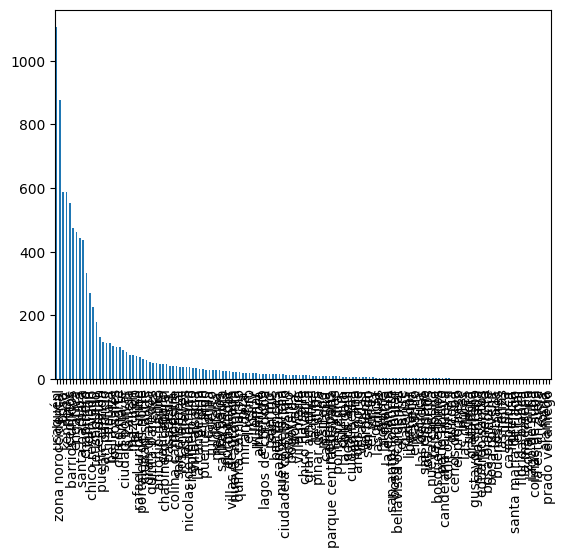

In [32]:
#se realiza un plot de barras inicial para mirar la cantidad de registros por barrio.
#sin embargo la gráfica no se ve muy bien por la cantidad de datos.
inmuebles_barrio = inmuebles.Barrio.value_counts()
inmuebles_barrio.plot.bar()

<Axes: >

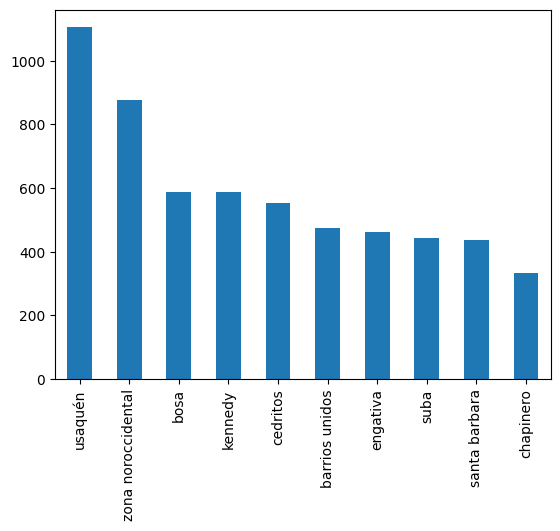

In [33]:
#se realiza el plot de los 10 barrios con mayor cantidad de registros
inmuebles_barrio.head(10).plot.bar()

## Desafío 1

- Promedio de área de todos los inmuebles en los barrios en el dataset. El top 10.


In [34]:
areainmuebles = inmuebles[['Barrio','Area']].groupby('Barrio').mean()

In [35]:
inmuebles[['Barrio','Area']].groupby('Barrio').mean()

,Area
Barrio,
alameda,97.00
alhambra,190.41
andes norte,124.86
antonio nariño,163.06
barrancas,70.20
...,...
villa maria,207.15
villas de granada,86.59
villemar,76.89


In [36]:
#areainmuebles.reset_index(inplace = True)

In [37]:
areainmuebles.head()

,Area
Barrio,
alameda,97.00
alhambra,190.41
andes norte,124.86
antonio nariño,163.06
barrancas,70.20


In [38]:
areainmuebles.sort_values(by='Area',ascending=False,inplace = True)

<Axes: xlabel='Barrio'>

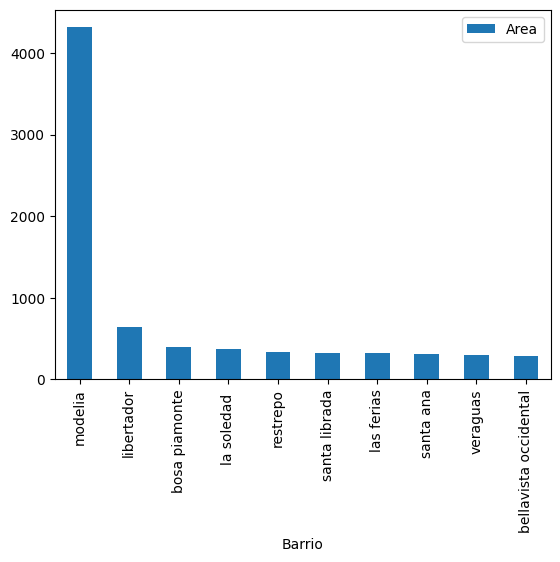

In [39]:
# plot de los 10 primeros barrios con el mayor promedio de área
areainmuebles.head(10).plot.bar()

- Consultar otros datos estadísticos, conteo, mediana, valores mínimo y máximo.

In [40]:
areainmuebles.describe()

,Area
count,149.00
mean,163.87
std,352.64
min,25.00
25%,77.00
50%,120.57
75%,170.35
max,4316.75


In [41]:
inmuebles.describe()

,Habitaciones,Banos,Area
count,9520.00,9520.00,9520.00
mean,3.07,2.45,146.66
std,2.05,1.26,1731.38
min,1.00,0.00,2.00
25%,2.00,2.00,57.00
50%,3.00,2.00,80.00
75%,3.00,3.00,135.00
max,110.00,9.00,166243.00


Se revisa con histogramas, la frecuencia de los datos por habitaciones, baños, área. 

array([[<Axes: title={'center': 'Habitaciones'}>,
        <Axes: title={'center': 'Banos'}>],
       [<Axes: title={'center': 'Area'}>, <Axes: >]], dtype=object)

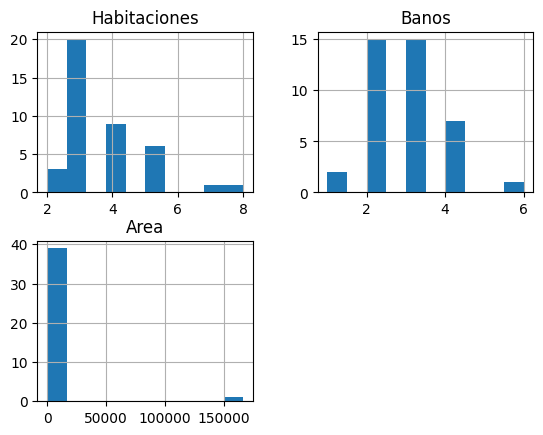

In [42]:
inmuebles[inmuebles['Barrio']=='modelia'].hist()

{'whiskers': [<matplotlib.lines.Line2D at 0x7f2eabb0a400>,
 'caps': [<matplotlib.lines.Line2D at 0x7f2eabaf85b0>,
 'boxes': [<matplotlib.lines.Line2D at 0x7f2eabbe9640>],
 'medians': [<matplotlib.lines.Line2D at 0x7f2eabaf8310>],
 'fliers': [<matplotlib.lines.Line2D at 0x7f2ea92b4100>],
 'means': []}

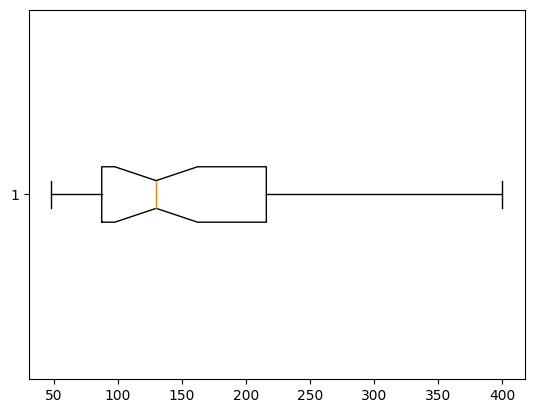

In [43]:
plt.boxplot(inmuebles['Area'][(inmuebles['Area']<=100000) & (inmuebles['Barrio']=='modelia')],notch = True,vert=False)

In [44]:
inmuebles['Area'][(inmuebles['Area']<=100000) & (inmuebles['Barrio']=='modelia')].describe()

count    39.00
mean    164.79
std      92.24
min      48.00
25%      87.50
50%     130.00
75%     216.00
max     400.00
Name: Area, dtype: float64

In [45]:
inmuebles['Area'][(inmuebles['Area']<=100000) & (inmuebles['Barrio']=='modelia')].median()

130.0

(array([9., 9., 2., 3., 7., 2., 3., 3., 0., 1.]),
 array([ 48. ,  83.2, 118.4, 153.6, 188.8, 224. , 259.2, 294.4, 329.6,
        364.8, 400. ]),
 <BarContainer object of 10 artists>)

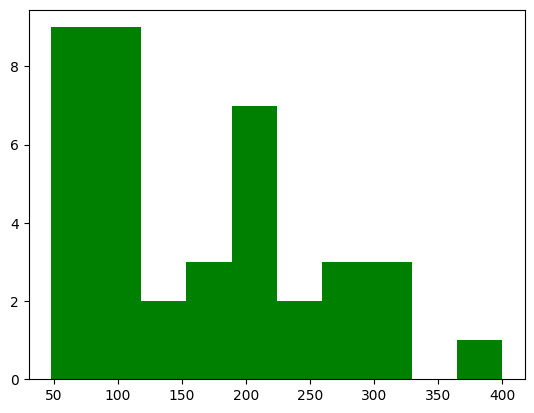

In [46]:
plt.hist(inmuebles['Area'][(inmuebles['Area']<=100000) & (inmuebles['Barrio']=='modelia')],color='green',)

In [47]:
inmuebles['Area'][(inmuebles['Area']<=200000) & (inmuebles['Barrio']=='modelia')].value_counts().sort_index()

48        1
53        1
60        2
70        2
78        3
87        1
88        2
92        1
106       1
108       3
112       1
120       1
130       1
181       3
200       1
209       2
210       2
212       1
220       1
236       1
244       1
270       1
275       1
287       1
320       3
400       1
166243    1
Name: Area, dtype: int64

In [48]:
inmuebles['Area'][(inmuebles['Area']<=100000) & (inmuebles['Barrio']=='modelia')].mean()

164.7948717948718

# Segundo día de inmersion de datos

Nos adentramos mas en los datos y buscamos ver mejor la distribución de los datos, complementandolo con un mejor uso de ciertas columnas que nos podrían aportar mayor información cambiando su tipo de dato.

In [49]:
inmuebles[['moneda','precio_millon']] = inmuebles['Valor'].str.split(' ',expand=True)

In [50]:
inmuebles.head()

,Tipo,Descripcion,Habitaciones,Banos,Area,Barrio,UPZ,Valor,moneda,precio_millon
0,Apartamento,Apartamento en venta en Zona Noroccidental,3,2,70,zona noroccidental,CHAPINERO: Pardo Rubio + Chapinero,$ 360.000.000,$,360.000.000
1,Casa,Casa en venta en Castilla,4,3,170,castilla,KENNEDY: Castilla + Bavaria,$ 670.000.000,$,670.000.000
2,Apartamento,Apartamento en venta en Chico Reservado,3,3,144,chico reservado,CHAPINERO: Chicó Lago + El Refugio,$ 1.120.000.000,$,1.120.000.000
3,Apartamento,Apartamento en venta en Usaquén,3,2,154,usaquén,Usaquén,$ 890.000.000,$,890.000.000
4,Apartamento,Apartamento en venta en Bella Suiza,2,3,128,bella suiza,USAQUÉN: Country Club + Santa Bárbara,$ 970.000.000,$,970.000.000


In [51]:
#se realiza el cast de los datos de los precio de los inmuebles de object a float de tal forma que pueda realizar
#mejores cálculos con dicha información
inmuebles['precio_millon'] = inmuebles['precio_millon'].str.replace('.','',regex=False).apply(lambda x: float(x)/1000000) 

In [52]:
inmuebles[['moneda','Valor','precio_millon']]

,moneda,Valor,precio_millon
0,$,$ 360.000.000,360.00
1,$,$ 670.000.000,670.00
2,$,$ 1.120.000.000,1120.00
3,$,$ 890.000.000,890.00
4,$,$ 970.000.000,970.00
...,...,...,...
9515,$,$ 290.000.000,290.00
9516,$,$ 670.000.000,670.00
9517,$,$ 900.000.000,900.00
9518,$,$ 335.000.000,335.00


In [53]:
#usa este codigo si requieres borrar una columna de tu dataset
#inmuebles.drop(columns='precio',inplace = True)

In [54]:
#otra manera de hacer un cambio de tipo dato de string a float
#inmuebles['precio_millon'] = inmuebles['precio_millon'].astype('float',errors='ignore')

In [55]:
inmuebles

,Tipo,Descripcion,Habitaciones,Banos,Area,Barrio,UPZ,Valor,moneda,precio_millon
0,Apartamento,Apartamento en venta en Zona Noroccidental,3,2,70,zona noroccidental,CHAPINERO: Pardo Rubio + Chapinero,$ 360.000.000,$,360.00
1,Casa,Casa en venta en Castilla,4,3,170,castilla,KENNEDY: Castilla + Bavaria,$ 670.000.000,$,670.00
2,Apartamento,Apartamento en venta en Chico Reservado,3,3,144,chico reservado,CHAPINERO: Chicó Lago + El Refugio,$ 1.120.000.000,$,1120.00
3,Apartamento,Apartamento en venta en Usaquén,3,2,154,usaquén,Usaquén,$ 890.000.000,$,890.00
4,Apartamento,Apartamento en venta en Bella Suiza,2,3,128,bella suiza,USAQUÉN: Country Club + Santa Bárbara,$ 970.000.000,$,970.00
...,...,...,...,...,...,...,...,...,...,...
9515,Apartamento,Apartamento en venta en Kennedy,3,2,70,kennedy,Kennedy Central,$ 290.000.000,$,290.00
9516,Apartamento,Apartamento en venta en Parque Central Bavaria,2,2,100,parque central bavaria,SANTA FE: Las Nieves + Sagrado Corazón,$ 670.000.000,$,670.00
9517,Local,Local en venta en Restrepo,8,6,383,restrepo,Restrepo,$ 900.000.000,$,900.00
9518,Casa,Casa en venta en Engativa,3,2,183,engativa,Engativá,$ 335.000.000,$,335.00


In [56]:
inmuebles.describe()

,Habitaciones,Banos,Area,precio_millon
count,9520.00,9520.00,9520.00,9520.00
mean,3.07,2.45,146.66,602.06
std,2.05,1.26,1731.38,704.60
min,1.00,0.00,2.00,60.00
25%,2.00,2.00,57.00,250.00
50%,3.00,2.00,80.00,409.18
75%,3.00,3.00,135.00,680.00
max,110.00,9.00,166243.00,16000.00


In [57]:
#utilizo loc para mirar que inmuebles cuentan con 110 habitaciones
inmuebles.loc[inmuebles.Habitaciones == 110]
#claramente se puede observar que es ilógico que una casa con esa área tenga 110
#habitaciones. Puede deberse a algún error de digitación

,Tipo,Descripcion,Habitaciones,Banos,Area,Barrio,UPZ,Valor,moneda,precio_millon
897,Casa,Casa en venta en La Uribe,110,2,110,la uribe,Usaquén,$ 480.000.000,$,480.00


In [58]:
#adicionalmente, miramos que hay un inmueble que tiene 2m2 de area, que es muy curios
#por lo que revisamos que inmuebles tienen esa condición
inmuebles.loc[inmuebles.Area == 2]
#es ilógico pesar que el inmueble tiene 3 habitaciones, vale 180 millones y solo tiene
#dos m2. Puede deberse a algún error de digitación

,Tipo,Descripcion,Habitaciones,Banos,Area,Barrio,UPZ,Valor,moneda,precio_millon
8401,Apartamento,Apartamento en venta en San Cristobal,3,1,2,san cristobal,Sosiego,$ 180.000.000,$,180.00


In [59]:
fig = px.histogram(inmuebles,x='precio_millon',nbins=10)
fig.show()

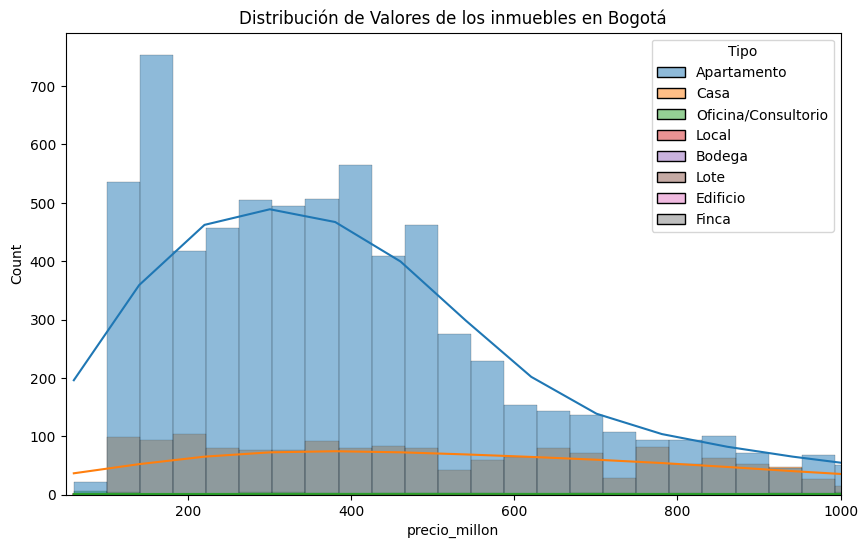

In [60]:
plt.figure(figsize=(10,6))
grafica = sns.histplot(data=inmuebles, x='precio_millon', kde=True, hue='Tipo')
grafica.set_title('Distribución de Valores de los inmuebles en Bogotá')
plt.xlim((50,1000))
#plt.savefig('/content/drive/MyDrive/inmersion_datos/valor_inmuebles.png',format='png')
plt.show()
     

## Desafíos

- Estudiar mejor el histograma de valores, seleccionar 3 tipos de inmuebles (Refinar el gráfico: Títulos, aumentar el tamaño de labels, colores, conclusión de la información)


In [61]:
#para seleccionar los tipos de inmuebles para el ejercicio, me voy a los 3 que tengan mayor cantidad
#de datos. Esto lo puedo evidenciar con value_counts()
inmuebles['Tipo'].value_counts()

Apartamento            7327
Casa                   2043
Oficina/Consultorio      60
Local                    38
Edificio                 22
Bodega                   13
Finca                    11
Lote                      6
Name: Tipo, dtype: int64

In [62]:
#Apartir de lo anterior, escogo ['Apartamento','Casa','Oficina/Consultorio'] que son los tipos de
#inmuebles (3 primeros) que tienen mayor cantidad de datos
fig = px.histogram(
    inmuebles[inmuebles['Tipo'].isin(['Apartamento','Casa','Oficina/Consultorio'])],
    x='precio_millon',
    title = 'Distribución de Valores (en Millones) de Apartamentos, Casas y Oficina/Consultorio en Bogotá D.C',
    labels = {'precio_millon':'Precio Inmuebles por Millones','y':'Cantidad'},
    opacity = 1,
    marginal = 'rug',
    #nbins=20,
    text_auto = True,
    color='Tipo')
fig.update_layout(yaxis_title='Cantidad')
fig.show()

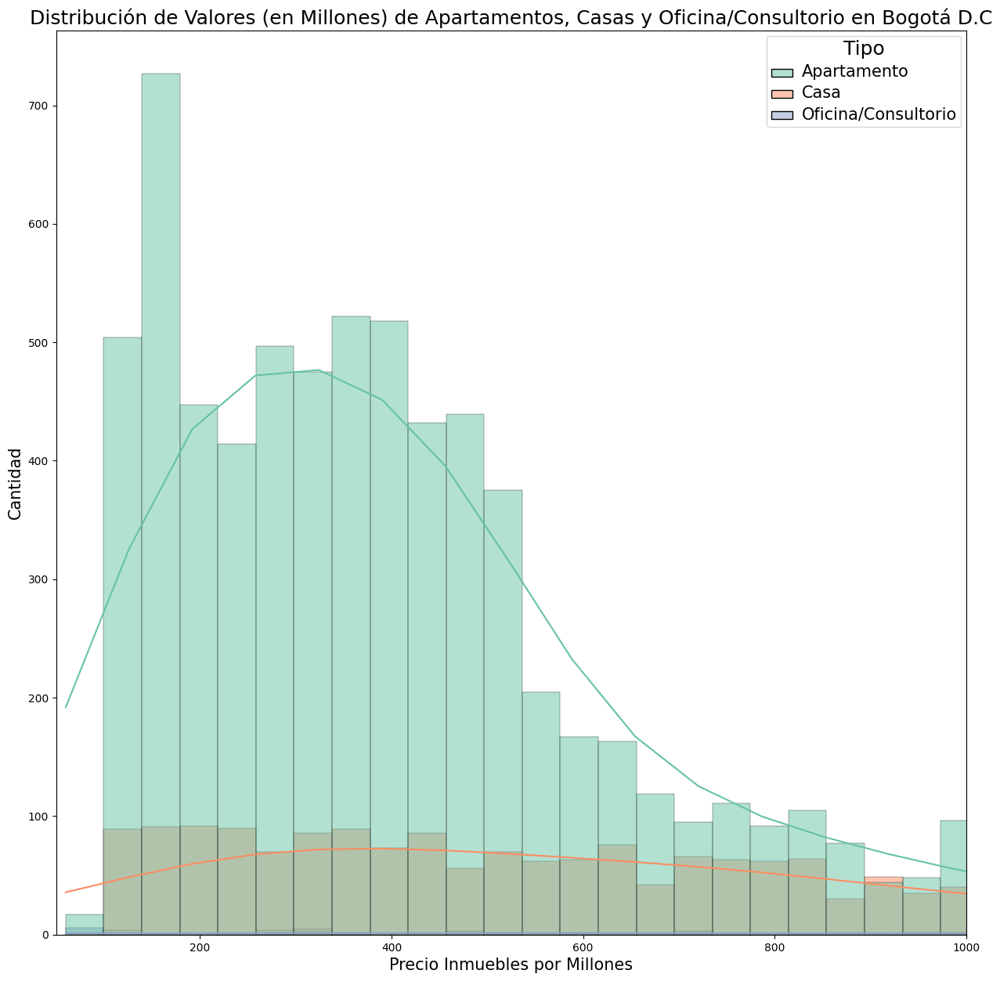

In [63]:
plt.figure(figsize=(15,15))

fig = sns.histplot(x="precio_millon",
                 kde=True,
                 hue="Tipo",
                 hue_order=["Apartamento", "Casa", "Oficina/Consultorio"],
                 palette="Set2",
                 data=inmuebles[inmuebles['Tipo'].isin(['Apartamento','Casa','Oficina/Consultorio'])])

fig.set_title("Distribución de Valores (en Millones) de Apartamentos, Casas y Oficina/Consultorio en Bogotá D.C", fontsize=18)

plt.setp(fig.get_legend().get_title(), fontsize=18)
plt.setp(fig.get_legend().get_texts(), fontsize=15)

plt.xlim((50, 1000))
fig.set_xlabel("Precio Inmuebles por Millones", fontsize=15)
fig.set_ylabel("Cantidad", fontsize=15)

plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
#plt.savefig("dia2_desafio1.png", format="png")

plt.show()

Conclusion: Se puede inferir que los Apartamentos y las Casas tienen la mayor cantidad de registros en la ciudad de bogotá dejando las Oficina/Consultorio con una pequeña parte del total. Así las cosas, se ve que la mayor distribución de estos inmuebles se presenta entre los 75 - 1025 millones, siendo la distribución sesgada a la derecha.  Claramente, esta conclusion es solo aplicable para estos tres tipos de inmuebles con el histograma visto teniendo en cuenta solo el precio en millones de los inmuebles.

- Precio del m2 por barrio y hacer el gráfico más adecuado para esta nueva variable.

Se filtra áreas mayores a 10.000 m2, puesto que vienen siendo ilógicas según los demás parámetros. por ejemplo: 1 apartamento tiene un area mayor a 1ha? eso es ilógico y no se ha visto en Bogotá o 1 apartamento con 2 m2 de área?. Por lo tanto filtramos la data quitando esos outliners.

In [64]:
data_filtrada = inmuebles[inmuebles['Tipo'].isin(['Apartamento','Casa','Oficina/Consultorio']) & (inmuebles['Area']<=10000) & (inmuebles['Area']>=20)]
data_filtrada

,Tipo,Descripcion,Habitaciones,Banos,Area,Barrio,UPZ,Valor,moneda,precio_millon
0,Apartamento,Apartamento en venta en Zona Noroccidental,3,2,70,zona noroccidental,CHAPINERO: Pardo Rubio + Chapinero,$ 360.000.000,$,360.00
1,Casa,Casa en venta en Castilla,4,3,170,castilla,KENNEDY: Castilla + Bavaria,$ 670.000.000,$,670.00
2,Apartamento,Apartamento en venta en Chico Reservado,3,3,144,chico reservado,CHAPINERO: Chicó Lago + El Refugio,$ 1.120.000.000,$,1120.00
3,Apartamento,Apartamento en venta en Usaquén,3,2,154,usaquén,Usaquén,$ 890.000.000,$,890.00
4,Apartamento,Apartamento en venta en Bella Suiza,2,3,128,bella suiza,USAQUÉN: Country Club + Santa Bárbara,$ 970.000.000,$,970.00
...,...,...,...,...,...,...,...,...,...,...
9514,Casa,Casa en venta en Kennedy,4,2,240,kennedy,Kennedy Central,$ 555.000.000,$,555.00
9515,Apartamento,Apartamento en venta en Kennedy,3,2,70,kennedy,Kennedy Central,$ 290.000.000,$,290.00
9516,Apartamento,Apartamento en venta en Parque Central Bavaria,2,2,100,parque central bavaria,SANTA FE: Las Nieves + Sagrado Corazón,$ 670.000.000,$,670.00
9518,Casa,Casa en venta en Engativa,3,2,183,engativa,Engativá,$ 335.000.000,$,335.00


In [65]:
data_filtrada

,Tipo,Descripcion,Habitaciones,Banos,Area,Barrio,UPZ,Valor,moneda,precio_millon
0,Apartamento,Apartamento en venta en Zona Noroccidental,3,2,70,zona noroccidental,CHAPINERO: Pardo Rubio + Chapinero,$ 360.000.000,$,360.00
1,Casa,Casa en venta en Castilla,4,3,170,castilla,KENNEDY: Castilla + Bavaria,$ 670.000.000,$,670.00
2,Apartamento,Apartamento en venta en Chico Reservado,3,3,144,chico reservado,CHAPINERO: Chicó Lago + El Refugio,$ 1.120.000.000,$,1120.00
3,Apartamento,Apartamento en venta en Usaquén,3,2,154,usaquén,Usaquén,$ 890.000.000,$,890.00
4,Apartamento,Apartamento en venta en Bella Suiza,2,3,128,bella suiza,USAQUÉN: Country Club + Santa Bárbara,$ 970.000.000,$,970.00
...,...,...,...,...,...,...,...,...,...,...
9514,Casa,Casa en venta en Kennedy,4,2,240,kennedy,Kennedy Central,$ 555.000.000,$,555.00
9515,Apartamento,Apartamento en venta en Kennedy,3,2,70,kennedy,Kennedy Central,$ 290.000.000,$,290.00
9516,Apartamento,Apartamento en venta en Parque Central Bavaria,2,2,100,parque central bavaria,SANTA FE: Las Nieves + Sagrado Corazón,$ 670.000.000,$,670.00
9518,Casa,Casa en venta en Engativa,3,2,183,engativa,Engativá,$ 335.000.000,$,335.00


In [66]:
data_filtrada['m2/millon'] = data_filtrada['precio_millon']/data_filtrada['Area']

<ipython-input-66-a2c49b7fb28e>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [67]:
#se agrupa la data por barrio
data_agrupada = data_filtrada[['Barrio','m2/millon']].groupby('Barrio').mean().reset_index()

In [68]:
data_agrupada

,Barrio,m2/millon
0,alameda,5.98
1,alhambra,4.33
2,andes norte,6.05
3,antonio nariño,3.53
4,barrancas,4.42
...,...,...
144,villa maria,2.04
145,villas de granada,3.07
146,villemar,3.99
147,zona franca,2.96


In [69]:
#Ahora graficamos con un diagrama de barras
fig = px.bar(
    data_agrupada.sort_values('m2/millon',ascending=False).head(20),
    x='Barrio',
    y='m2/millon',
    title = 'Los 20 barrios con el m2 mas caro de la ciudad de Bogota DC',
    labels = {'Barrio':'Barrios','m2/millon':'precio m2 por millon'},
    opacity = 1,
    #nbins=20,
    text_auto = True,
    color='m2/millon',
    color_continuous_scale=px.colors.sequential.Turbo
    #orientation = 'h'
    )
#fig.update_layout(yaxis_title='Cantidad')
fig.show()

Revision de otra manera de agrupar los datos y calcular la relacion m2 por millon por barrio

In [70]:
inmuebles['m2/millon'] = inmuebles['precio_millon']/inmuebles['Area']
inmuebles.head()

,Tipo,Descripcion,Habitaciones,Banos,Area,Barrio,UPZ,Valor,moneda,precio_millon,m2/millon
0,Apartamento,Apartamento en venta en Zona Noroccidental,3,2,70,zona noroccidental,CHAPINERO: Pardo Rubio + Chapinero,$ 360.000.000,$,360.00,5.14
1,Casa,Casa en venta en Castilla,4,3,170,castilla,KENNEDY: Castilla + Bavaria,$ 670.000.000,$,670.00,3.94
2,Apartamento,Apartamento en venta en Chico Reservado,3,3,144,chico reservado,CHAPINERO: Chicó Lago + El Refugio,$ 1.120.000.000,$,1120.00,7.78
3,Apartamento,Apartamento en venta en Usaquén,3,2,154,usaquén,Usaquén,$ 890.000.000,$,890.00,5.78
4,Apartamento,Apartamento en venta en Bella Suiza,2,3,128,bella suiza,USAQUÉN: Country Club + Santa Bárbara,$ 970.000.000,$,970.00,7.58


In [71]:
datos_barrio = inmuebles.groupby('Barrio').sum()
datos_barrio.head()

,Habitaciones,Banos,Area,precio_millon,m2/millon
Barrio,,,,,
alameda,3,2,97,580.00,5.98
alhambra,51,50,3237,12790.00,73.56
andes norte,21,20,874,4967.00,42.35
antonio nariño,207,120,7827,22042.65,169.47
barrancas,43,32,1053,4712.00,66.24


In [72]:
datos_barrio['Valor_m2_Barrio'] = datos_barrio['precio_millon']/datos_barrio['Area']
datos_barrio.head()

,Habitaciones,Banos,Area,precio_millon,m2/millon,Valor_m2_Barrio
Barrio,,,,,,
alameda,3,2,97,580.00,5.98,5.98
alhambra,51,50,3237,12790.00,73.56,3.95
andes norte,21,20,874,4967.00,42.35,5.68
antonio nariño,207,120,7827,22042.65,169.47,2.82
barrancas,43,32,1053,4712.00,66.24,4.47


In [73]:
m2_barrio = dict(datos_barrio['Valor_m2_Barrio'])

In [74]:
inmuebles['Valor_m2_Barrio'] = inmuebles['Barrio'].map(m2_barrio)
inmuebles

,Tipo,Descripcion,Habitaciones,Banos,Area,Barrio,UPZ,Valor,moneda,precio_millon,m2/millon,Valor_m2_Barrio
0,Apartamento,Apartamento en venta en Zona Noroccidental,3,2,70,zona noroccidental,CHAPINERO: Pardo Rubio + Chapinero,$ 360.000.000,$,360.00,5.14,4.57
1,Casa,Casa en venta en Castilla,4,3,170,castilla,KENNEDY: Castilla + Bavaria,$ 670.000.000,$,670.00,3.94,3.40
2,Apartamento,Apartamento en venta en Chico Reservado,3,3,144,chico reservado,CHAPINERO: Chicó Lago + El Refugio,$ 1.120.000.000,$,1120.00,7.78,8.10
3,Apartamento,Apartamento en venta en Usaquén,3,2,154,usaquén,Usaquén,$ 890.000.000,$,890.00,5.78,5.66
4,Apartamento,Apartamento en venta en Bella Suiza,2,3,128,bella suiza,USAQUÉN: Country Club + Santa Bárbara,$ 970.000.000,$,970.00,7.58,6.29
...,...,...,...,...,...,...,...,...,...,...,...,...
9515,Apartamento,Apartamento en venta en Kennedy,3,2,70,kennedy,Kennedy Central,$ 290.000.000,$,290.00,4.14,3.38
9516,Apartamento,Apartamento en venta en Parque Central Bavaria,2,2,100,parque central bavaria,SANTA FE: Las Nieves + Sagrado Corazón,$ 670.000.000,$,670.00,6.70,6.11
9517,Local,Local en venta en Restrepo,8,6,383,restrepo,Restrepo,$ 900.000.000,$,900.00,2.35,2.92
9518,Casa,Casa en venta en Engativa,3,2,183,engativa,Engativá,$ 335.000.000,$,335.00,1.83,2.89


# Tercer día de inmersion de datos

In [75]:
top_barrios = inmuebles['Barrio'].value_counts()[:10].index

In [76]:
top_barrios

Index(['usaquén', 'zona noroccidental', 'bosa', 'kennedy', 'cedritos',
       'barrios unidos', 'engativa', 'suba', 'santa barbara', 'chapinero'],
      dtype='object')

In [77]:
datos_barrio.reset_index(inplace=True)

In [78]:
datos_barrio

,Barrio,Habitaciones,Banos,Area,precio_millon,m2/millon,Valor_m2_Barrio
0,alameda,3,2,97,580.00,5.98,5.98
1,alhambra,51,50,3237,12790.00,73.56,3.95
2,andes norte,21,20,874,4967.00,42.35,5.68
3,antonio nariño,207,120,7827,22042.65,169.47,2.82
4,barrancas,43,32,1053,4712.00,66.24,4.47
...,...,...,...,...,...,...,...
144,villa maria,61,48,2693,5237.00,26.58,1.94
145,villas de granada,76,51,1905,6210.62,69.71,3.26
146,villemar,53,37,1384,5469.00,71.81,3.95
147,zona franca,2,1,54,160.00,2.96,2.96


In [79]:
datos_barrio.query('Barrio in @top_barrios')

,Barrio,Habitaciones,Banos,Area,precio_millon,m2/millon,Valor_m2_Barrio
5,barrios unidos,1525,1196,87799,259877.76,2070.61,2.96
10,bosa,1743,789,34879,93400.56,1654.36,2.68
22,cedritos,1458,1348,53711,270027.73,2853.23,5.03
24,chapinero,892,913,81248,372130.93,2466.03,4.58
50,engativa,1676,1077,59808,172711.73,1795.71,2.89
63,kennedy,2151,1233,61475,207963.65,2127.66,3.38
125,santa barbara,1073,1162,54693,320097.80,2701.88,5.85
132,suba,1497,1202,61615,266406.04,2000.72,4.32
138,usaquén,3109,3044,148121,837710.36,6334.04,5.66
148,zona noroccidental,2778,2204,119084,544453.06,4049.16,4.57


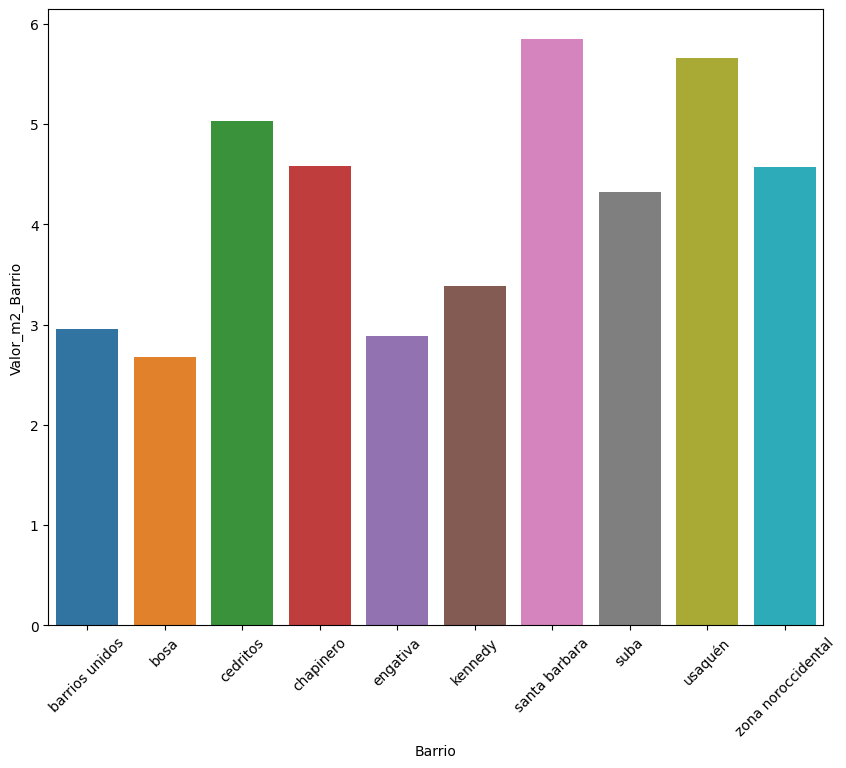

In [80]:
plt.figure(figsize=(10,8))
ax = sns.barplot(data = datos_barrio.query('Barrio in @top_barrios'), x = 'Barrio', y= 'Valor_m2_Barrio')
ax.tick_params(axis='x', rotation = 45)

In [81]:
inmuebles

,Tipo,Descripcion,Habitaciones,Banos,Area,Barrio,UPZ,Valor,moneda,precio_millon,m2/millon,Valor_m2_Barrio
0,Apartamento,Apartamento en venta en Zona Noroccidental,3,2,70,zona noroccidental,CHAPINERO: Pardo Rubio + Chapinero,$ 360.000.000,$,360.00,5.14,4.57
1,Casa,Casa en venta en Castilla,4,3,170,castilla,KENNEDY: Castilla + Bavaria,$ 670.000.000,$,670.00,3.94,3.40
2,Apartamento,Apartamento en venta en Chico Reservado,3,3,144,chico reservado,CHAPINERO: Chicó Lago + El Refugio,$ 1.120.000.000,$,1120.00,7.78,8.10
3,Apartamento,Apartamento en venta en Usaquén,3,2,154,usaquén,Usaquén,$ 890.000.000,$,890.00,5.78,5.66
4,Apartamento,Apartamento en venta en Bella Suiza,2,3,128,bella suiza,USAQUÉN: Country Club + Santa Bárbara,$ 970.000.000,$,970.00,7.58,6.29
...,...,...,...,...,...,...,...,...,...,...,...,...
9515,Apartamento,Apartamento en venta en Kennedy,3,2,70,kennedy,Kennedy Central,$ 290.000.000,$,290.00,4.14,3.38
9516,Apartamento,Apartamento en venta en Parque Central Bavaria,2,2,100,parque central bavaria,SANTA FE: Las Nieves + Sagrado Corazón,$ 670.000.000,$,670.00,6.70,6.11
9517,Local,Local en venta en Restrepo,8,6,383,restrepo,Restrepo,$ 900.000.000,$,900.00,2.35,2.92
9518,Casa,Casa en venta en Engativa,3,2,183,engativa,Engativá,$ 335.000.000,$,335.00,1.83,2.89


In [82]:
inmuebles.query('Barrio in @top_barrios')

,Tipo,Descripcion,Habitaciones,Banos,Area,Barrio,UPZ,Valor,moneda,precio_millon,m2/millon,Valor_m2_Barrio
0,Apartamento,Apartamento en venta en Zona Noroccidental,3,2,70,zona noroccidental,CHAPINERO: Pardo Rubio + Chapinero,$ 360.000.000,$,360.00,5.14,4.57
3,Apartamento,Apartamento en venta en Usaquén,3,2,154,usaquén,Usaquén,$ 890.000.000,$,890.00,5.78,5.66
14,Apartamento,Apartamento en venta en Kennedy,4,3,98,kennedy,Kennedy Central,$ 680.000.000,$,680.00,6.94,3.38
15,Casa,Casa en venta en Zona Noroccidental,3,4,300,zona noroccidental,CHAPINERO: Pardo Rubio + Chapinero,$ 2.519.000.000,$,2519.00,8.40,4.57
18,Apartamento,Apartamento en venta en Zona Noroccidental,2,1,45,zona noroccidental,CHAPINERO: Pardo Rubio + Chapinero,$ 239.000.000,$,239.00,5.31,4.57
...,...,...,...,...,...,...,...,...,...,...,...,...
9509,Apartamento,Apartamento en venta en Usaquén,3,3,180,usaquén,Usaquén,$ 1.250.000.000,$,1250.00,6.94,5.66
9512,Casa,Casa en venta en Kennedy,7,4,270,kennedy,Kennedy Central,$ 615.000.000,$,615.00,2.28,3.38
9514,Casa,Casa en venta en Kennedy,4,2,240,kennedy,Kennedy Central,$ 555.000.000,$,555.00,2.31,3.38
9515,Apartamento,Apartamento en venta en Kennedy,3,2,70,kennedy,Kennedy Central,$ 290.000.000,$,290.00,4.14,3.38


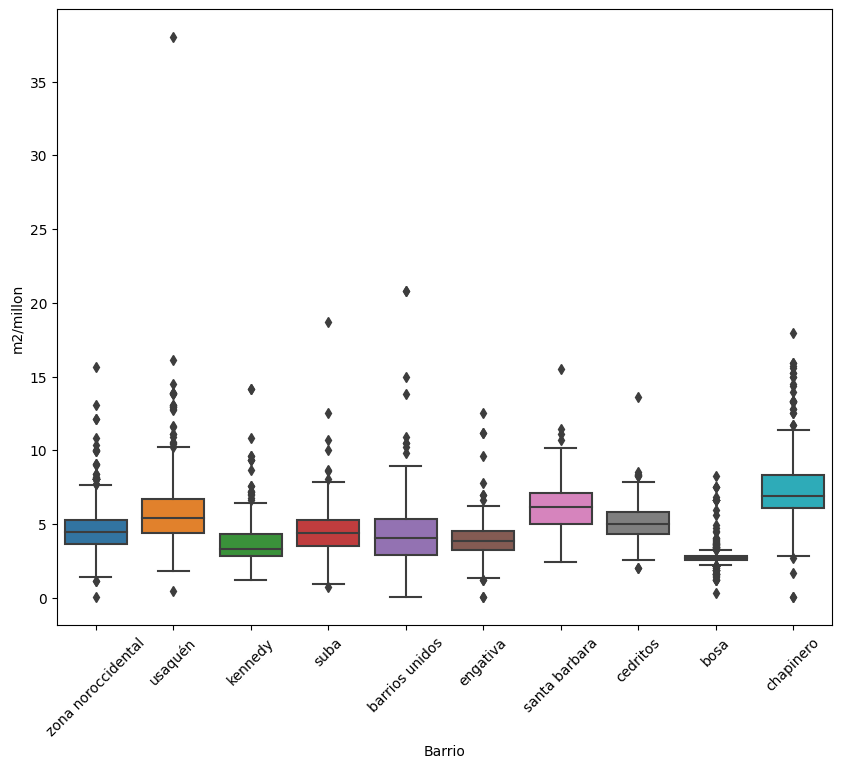

In [83]:
plt.figure(figsize=(10,8))
ax = sns.boxplot(x="Barrio", y="m2/millon", data = inmuebles.query('Barrio in @top_barrios'))
ax.tick_params(axis='x', rotation=45)
plt.show()
     

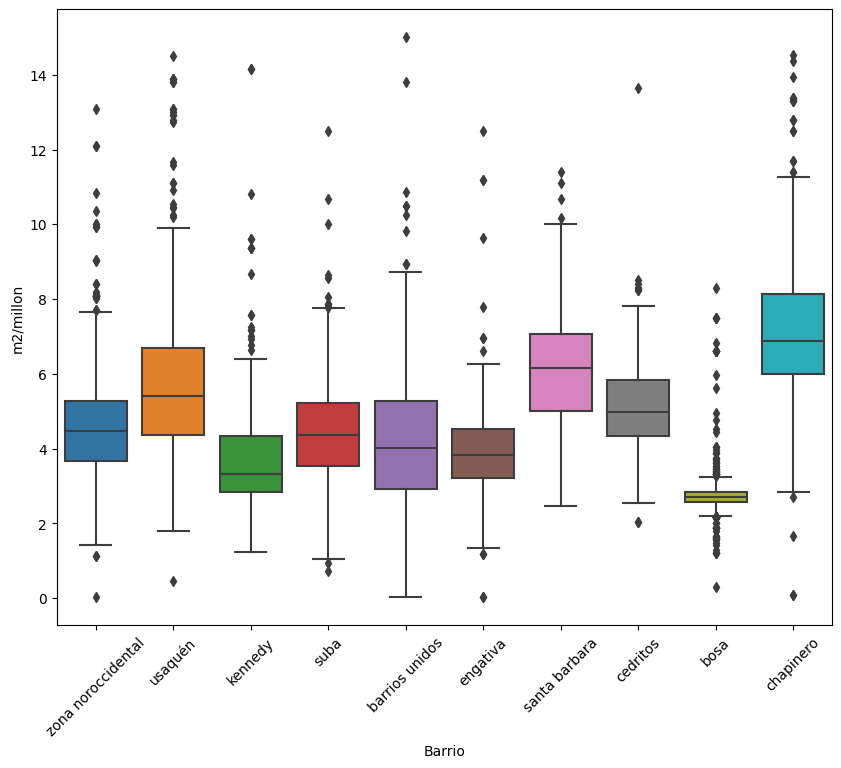

In [84]:
plt.figure(figsize=(10,8))
ax = sns.boxplot(x="Barrio", y="m2/millon", data = inmuebles[(inmuebles['Barrio'].isin(top_barrios)) & (inmuebles['m2/millon'] < 15)])
ax.tick_params(axis='x', rotation=45)
plt.show()

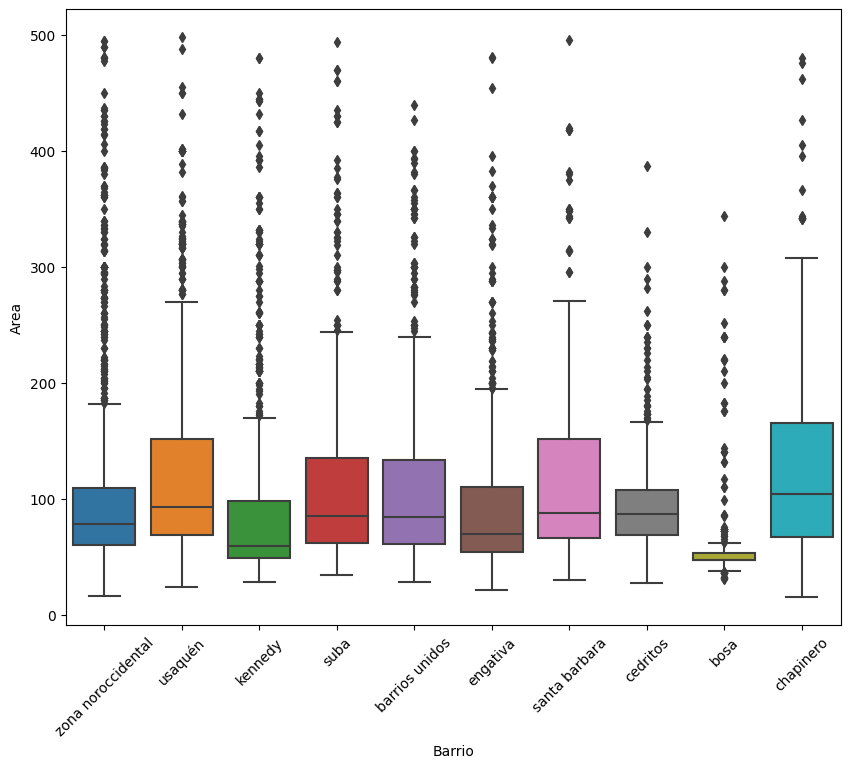

In [85]:
plt.figure(figsize=(10,8))
ax = sns.boxplot(x="Barrio", y="Area", data = inmuebles[(inmuebles['Barrio'].isin(top_barrios)) & (inmuebles['Area']<500)])
ax.tick_params(axis='x', rotation=45)
plt.show()

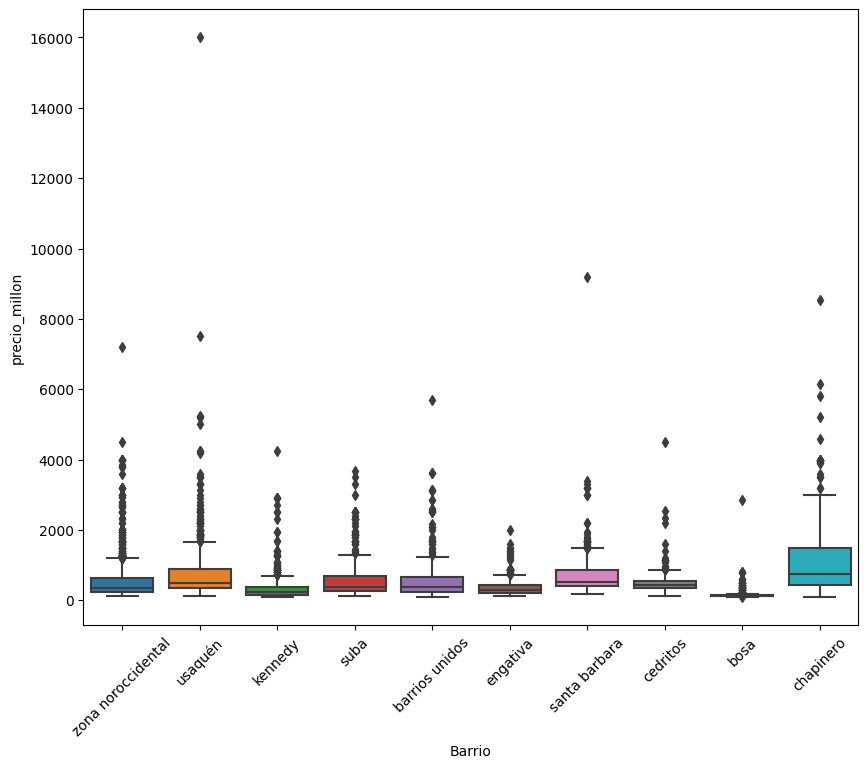

In [86]:
plt.figure(figsize=(10,8))
ax = sns.boxplot(x="Barrio", y="precio_millon", data = inmuebles[(inmuebles['Barrio'].isin(top_barrios))])
ax.tick_params(axis='x', rotation=45)
plt.show()

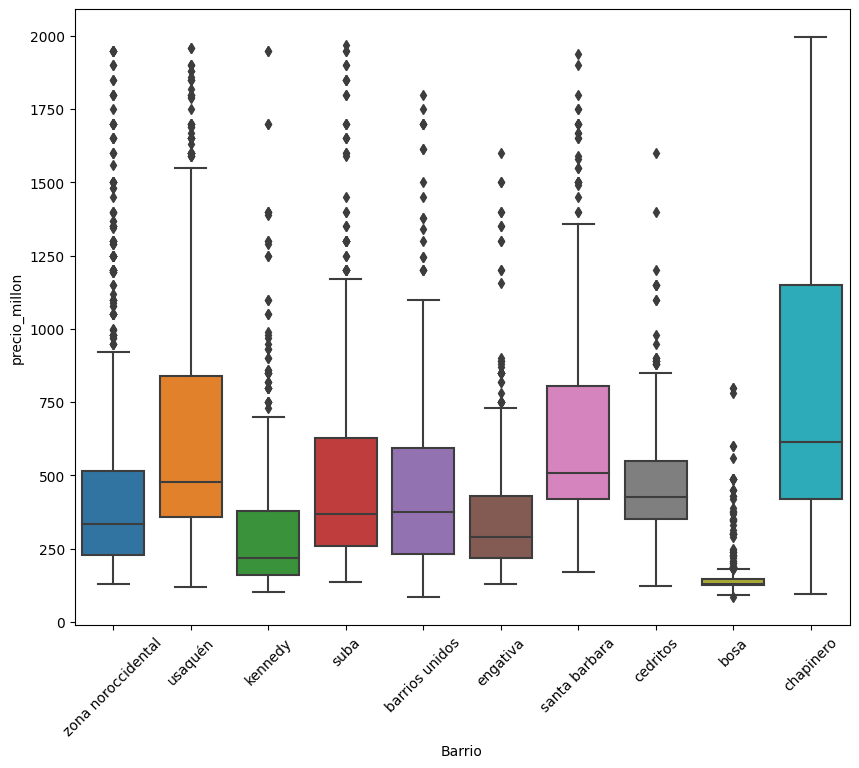

In [87]:
plt.figure(figsize=(10,8))
ax = sns.boxplot(x="Barrio", y="precio_millon", data = inmuebles[(inmuebles['Barrio'].isin(top_barrios)) & (inmuebles['precio_millon']<2000)])
ax.tick_params(axis='x', rotation=45)
plt.show()

Vamos a traer datos estadísticos de la ciudad de Bogotá, directamente del DANE y vamos a ver como estos datos nos ayudarían en inclusión de nuevas variables para el cálculo del precio de los inmuebles en la ciudad de Bogotá.

Encuesta Multiproposito de Bogotá para obtener información socio-económica y de entorno urbano de los habitantes de Bogotá para la formulación, seguimiento y evaluación de las políticas distritales.

[datos Dane](https://microdatos.dane.gov.co/index.php/catalog/743)

In [88]:
datos_raw = pd.read_csv('/content/drive/MyDrive/CURSOS Y DIPLOMAS/inmersion_datos/archivos-dane/Identificación (Capítulo A).csv', sep = ';',encoding='latin-1')
datos_raw.head()

,DIRECTORIO,DPTO,MPIO,CLASE,COD_LOCALIDAD,NOMBRE_LOCALIDAD,COD_UPZ_GRUPO,NOMBRE_UPZ_GRUPO,ESTRATO2021,NOMBRE_ESTRATO,FEX_C
0,3004346.00,11,11001,1,3.00,Santa Fe,814.00,SANTA FE: Las Nieves + Sagrado Corazón,11001187,SANTA FE: Las Nieves + Sagrado Corazón,"13,2266692027239"
1,3004347.00,11,11001,1,14.00,Los Mártires,37.00,Santa Isabel,11001162,Santa Isabel,"17,8555889419101"
2,3004348.00,11,11001,1,3.00,Santa Fe,814.00,SANTA FE: Las Nieves + Sagrado Corazón,11001187,SANTA FE: Las Nieves + Sagrado Corazón,"10,0286103658331"
3,3004349.00,11,11001,1,1.00,Usaquén,803.00,USAQUÉN: Country Club + Santa Bárbara,11001176,USAQUÉN: Country Club + Santa Bárbara,"28,6502122142802"
4,3004350.00,11,11001,1,1.00,Usaquén,803.00,USAQUÉN: Country Club + Santa Bárbara,11001176,USAQUÉN: Country Club + Santa Bárbara,"24,4684068319009"


In [89]:
datos_raw.shape

(106467, 11)

In [90]:
datos_raw = datos_raw.loc[datos_raw.MPIO == 11001]

In [91]:
datos_raw.shape

(86504, 11)

In [92]:
datos_b = pd.read_csv('/content/drive/MyDrive/CURSOS Y DIPLOMAS/inmersion_datos/archivos-dane/Datos de la vivenda y su entorno (Capítulo B).csv',sep=';',encoding='latin-1')
datos_c = pd.read_csv('/content/drive/MyDrive/CURSOS Y DIPLOMAS/inmersion_datos/archivos-dane/Condiciones habitacionales del hogar (Capítulo C).csv',sep=';',encoding='latin-1')
datos_e = pd.read_csv('/content/drive/MyDrive/CURSOS Y DIPLOMAS/inmersion_datos/archivos-dane/Composición del hogar y demografía (Capítulo E).csv',sep=';',encoding='latin-1')
datos_h = pd.read_csv('/content/drive/MyDrive/CURSOS Y DIPLOMAS/inmersion_datos/archivos-dane/Educación (Capítulo H).csv',sep=';',encoding='latin-1')
datos_l = pd.read_csv('/content/drive/MyDrive/CURSOS Y DIPLOMAS/inmersion_datos/archivos-dane/Percepción sobre las condiciones de vida y el desempeño institucional (Capítulo L).csv',sep=';',encoding='latin-1')
datos_k = pd.read_csv('/content/drive/MyDrive/CURSOS Y DIPLOMAS/inmersion_datos/archivos-dane/Fuerza de trabajo (Capítulo K).csv',sep=';',encoding='latin-1')
     

<ipython-input-92-490608ac6650>:2: DtypeWarning:

Columns (4,25,30,47) have mixed types. Specify dtype option on import or set low_memory=False.

<ipython-input-92-490608ac6650>:3: DtypeWarning:

Columns (66) have mixed types. Specify dtype option on import or set low_memory=False.

<ipython-input-92-490608ac6650>:4: DtypeWarning:

Columns (81) have mixed types. Specify dtype option on import or set low_memory=False.

<ipython-input-92-490608ac6650>:5: DtypeWarning:

Columns (114,117,122,126,164,166,168) have mixed types. Specify dtype option on import or set low_memory=False.

<ipython-input-92-490608ac6650>:6: DtypeWarning:

Columns (27,58,60,62,64,66,104,114,120,124,126,129,131,133) have mixed types. Specify dtype option on import or set low_memory=False.



In [93]:
datos_dane = pd.merge(datos_raw,datos_b,on='DIRECTORIO', how='left')
datos_dane.shape

(86504, 73)

In [94]:
datos_dane = pd.merge(datos_dane,datos_c,on='DIRECTORIO', how='left')
datos_dane.shape

(87061, 214)

In [95]:
datos_dane = pd.merge(datos_dane,datos_e,on='DIRECTORIO', how='left')

<ipython-input-95-94d5bdd5b9a5>:1: FutureWarning:

Passing 'suffixes' which cause duplicate columns {'FEX_C_x'} in the result is deprecated and will raise a MergeError in a future version.



In [96]:
datos_dane.shape

(238559, 281)

In [97]:
datos_dane.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 238559 entries, 0 to 238558
Columns: 281 entries, DIRECTORIO to FEX_C_y
dtypes: float64(140), int64(126), object(15)
memory usage: 513.3+ MB


## **Desafio**



1. Dar un vistazo a la base de datos del DANE, entender estas variables conceptualmente para entender mejor el contexto de esta base.
2. Organizar tu notebook para que tu proyecto quede mejor presentado.



In [98]:
datos_dane = pd.read_csv('/content/drive/MyDrive/CURSOS Y DIPLOMAS/inmersion_datos/datos_dane.csv')
datos_dane.head()

,DIRECTORIO,NOMBRE_LOCALIDAD,NOMBRE_ESTRATO,NVCBP4,NVCBP14A,NVCBP14D,NVCBP14E,NVCBP14G,NVCBP15A,NVCBP15C,...,NHCLP5,NHCLP8AB,NHCLP8AE,NHCLP10,NHCLP11,NHCLP29_1A,NHCLP29_1C,NHCLP29_1E,NHCLP29_1F,NPCHP4
0,3004368.00,Usaquén,USAQUÉN: Paseo de Los Libertadores + La Uribe,1,2,2,2,2,2,2,...,1,NaN,NaN,2,2,NaN,NaN,NaN,NaN,9.00
1,3004369.00,Usaquén,Usaquén,1,2,2,2,2,2,2,...,2,NaN,NaN,3,2,NaN,NaN,NaN,NaN,11.00
2,3004375.00,Chapinero,CHAPINERO: Pardo Rubio + Chapinero,2,2,2,2,2,2,1,...,2,NaN,NaN,2,2,NaN,NaN,1.00,NaN,11.00
3,3004380.00,Usaquén,Los Cedros,1,2,2,2,2,2,2,...,1,NaN,NaN,3,2,NaN,NaN,NaN,NaN,9.00
4,3004383.00,Fontibón,Ciudad Salitre Occidental,1,2,2,2,2,1,2,...,2,NaN,NaN,2,2,NaN,NaN,NaN,NaN,11.00


In [99]:
datos_dane.shape

(9857, 55)

In [100]:
datos_dane.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9857 entries, 0 to 9856
Data columns (total 55 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   DIRECTORIO        9857 non-null   float64
 1   NOMBRE_LOCALIDAD  9857 non-null   object 
 2   NOMBRE_ESTRATO    9857 non-null   object 
 3   NVCBP4            9857 non-null   int64  
 4   NVCBP14A          9857 non-null   int64  
 5   NVCBP14D          9857 non-null   int64  
 6   NVCBP14E          9857 non-null   int64  
 7   NVCBP14G          9857 non-null   int64  
 8   NVCBP15A          9857 non-null   int64  
 9   NVCBP15C          9857 non-null   int64  
 10  NVCBP15F          9857 non-null   int64  
 11  NVCBP15G          9857 non-null   int64  
 12  NVCBP16A3         9857 non-null   int64  
 13  NVCBP16A4         9857 non-null   int64  
 14  NPCKP17           9857 non-null   float64
 15  NPCKP18           9857 non-null   float64
 16  NPCKP23           9558 non-null   float64


In [101]:
dic_dane = {
       'NVCBP4':'CONJUNTO_CERRADO',
       'NVCBP14A':'FABRICAS_CERCA', 'NVCBP14D':'TERMINALES_BUS', 'NVCBP14E':'BARES_DISCO', 
       'NVCBP14G':'OSCURO_PELIGROSO', 'NVCBP15A':'RUIDO', 'NVCBP15C':'INSEGURIDAD',
       'NVCBP15F':'BASURA_INADECUADA', 'NVCBP15G':'INVASION','NVCBP16A3':'MOV_ADULTOS_MAYORES', 
       'NVCBP16A4':'MOV_NINOS_BEBES',
       'NPCKP17':'OCUPACION','NPCKP18':'CONTRATO','NPCKP23':'SALARIO_MES', 
       'NPCKP44A':'DONDE_TRABAJA', 'NPCKPN62A':'DECLARACION_RENTA', 
       'NPCKPN62B':'VALOR_DECLARACION', 'NPCKP64A':'PERDIDA_TRABAJO_C19', 
       'NPCKP64E':'PERDIDA_INGRESOS_C19',
       'NHCCP3':'TIENE_ESCRITURA', 'NHCCP6':'ANO_COMPRA', 'NHCCP7':'VALOR_COMPRA', 'NHCCP8_1':'HIPOTECA_CRED_BANCO',
       'NHCCP8_2':'OTRO_CRED_BANCO', 'NHCCP8_3':'CRED_FNA', 'NHCCP8_6':'PRESTAMOS_AMIGOS',
       'NHCCP8_7':'CESANTIAS', 'NHCCP8_8':'AHORROS', 'NHCCP8_9':'SUBSIDIOS',
       'NHCCP9':'CUANTO_PAGARIA_MENSUAL', 'NHCCP11':'PLANES_ADQUIRIR_VIVIENDA', 
       'NHCCP11A':'MOTIVO_COMPRA', 'NHCCP12':'RAZON_NO_ADQ_VIV', 'NHCCP41':'TIENE_CARRO','NHCCP41A':'CUANTOS_CARROS',
       'NHCCP47A':'TIENE_PERROS', 'NHCCP47B':'TIENE_GATOS', 'NHCLP2A':'VICTIMA_ATRACO', 'NHCLP2B':'VICTIMA_HOMICIDIO', 
       'NHCLP2C':'VICTIMA_PERSECUSION',
       'NHCLP2E':'VICTIMA_ACOSO', 'NHCLP4':'COMO_VIVE_ECON', 'NHCLP5':'COMO_NIVEL_VIDA', 
       'NHCLP8AB':'REACCION_OPORTUNA_POLICIA', 'NHCLP8AE':'COMO_TRANSPORTE_URBANO', 'NHCLP10':'SON_INGRESOS_SUFICIENTES',
       'NHCLP11':'SE_CONSIDERA_POBRE', 'NHCLP29_1A':'MED_C19_TRABAJO', 
       'NHCLP29_1C':'MED_C19_CAMBIO_VIVIENDA', 'NHCLP29_1E':'MED_C19_ENDEUDAMIENTO', 
       'NHCLP29_1F':'MED_C19_VENTA_BIENES','NPCHP4':'NIVEL_EDUCATIVO'
       }

datos_dane = datos_dane.rename(columns=dic_dane)
datos_dane.columns

Index(['DIRECTORIO', 'NOMBRE_LOCALIDAD', 'NOMBRE_ESTRATO', 'CONJUNTO_CERRADO',
       'FABRICAS_CERCA', 'TERMINALES_BUS', 'BARES_DISCO', 'OSCURO_PELIGROSO',
       'RUIDO', 'INSEGURIDAD', 'BASURA_INADECUADA', 'INVASION',
       'MOV_ADULTOS_MAYORES', 'MOV_NINOS_BEBES', 'OCUPACION', 'CONTRATO',
       'SALARIO_MES', 'DONDE_TRABAJA', 'DECLARACION_RENTA',
       'VALOR_DECLARACION', 'PERDIDA_TRABAJO_C19', 'PERDIDA_INGRESOS_C19',
       'TIENE_ESCRITURA', 'ANO_COMPRA', 'VALOR_COMPRA', 'HIPOTECA_CRED_BANCO',
       'OTRO_CRED_BANCO', 'CRED_FNA', 'PRESTAMOS_AMIGOS', 'CESANTIAS',
       'AHORROS', 'SUBSIDIOS', 'CUANTO_PAGARIA_MENSUAL',
       'PLANES_ADQUIRIR_VIVIENDA', 'MOTIVO_COMPRA', 'RAZON_NO_ADQ_VIV',
       'TIENE_CARRO', 'CUANTOS_CARROS', 'TIENE_PERROS', 'TIENE_GATOS',
       'VICTIMA_ATRACO', 'VICTIMA_HOMICIDIO', 'VICTIMA_PERSECUSION',
       'VICTIMA_ACOSO', 'COMO_VIVE_ECON', 'COMO_NIVEL_VIDA',
       'REACCION_OPORTUNA_POLICIA', 'COMO_TRANSPORTE_URBANO',
       'SON_INGRESOS_SUFICIE

In [102]:
datos_dane.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9857 entries, 0 to 9856
Data columns (total 55 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   DIRECTORIO                 9857 non-null   float64
 1   NOMBRE_LOCALIDAD           9857 non-null   object 
 2   NOMBRE_ESTRATO             9857 non-null   object 
 3   CONJUNTO_CERRADO           9857 non-null   int64  
 4   FABRICAS_CERCA             9857 non-null   int64  
 5   TERMINALES_BUS             9857 non-null   int64  
 6   BARES_DISCO                9857 non-null   int64  
 7   OSCURO_PELIGROSO           9857 non-null   int64  
 8   RUIDO                      9857 non-null   int64  
 9   INSEGURIDAD                9857 non-null   int64  
 10  BASURA_INADECUADA          9857 non-null   int64  
 11  INVASION                   9857 non-null   int64  
 12  MOV_ADULTOS_MAYORES        9857 non-null   int64  
 13  MOV_NINOS_BEBES            9857 non-null   int64

In [103]:
datos_dane.groupby('NOMBRE_ESTRATO')[['CONJUNTO_CERRADO','INSEGURIDAD','TERMINALES_BUS','BARES_DISCO','RUIDO','OSCURO_PELIGROSO','SALARIO_MES','TIENE_ESCRITURA','PERDIDA_TRABAJO_C19','PERDIDA_INGRESOS_C19','PLANES_ADQUIRIR_VIVIENDA']].mean().head()

,CONJUNTO_CERRADO,INSEGURIDAD,TERMINALES_BUS,BARES_DISCO,RUIDO,OSCURO_PELIGROSO,SALARIO_MES,TIENE_ESCRITURA,PERDIDA_TRABAJO_C19,PERDIDA_INGRESOS_C19,PLANES_ADQUIRIR_VIVIENDA
NOMBRE_ESTRATO,,,,,,,,,,,
20 de Julio,1.89,1.19,1.85,1.89,1.56,1.84,1493859.61,1.16,1.92,1.68,1.80
Américas,1.38,1.25,1.98,1.79,1.61,1.92,2672138.14,1.06,1.97,1.72,1.85
Apogeo,1.65,1.30,1.75,1.94,1.68,2.00,1837583.18,1.08,1.92,1.65,1.92
Arborizadora,1.43,1.30,1.95,1.88,1.69,1.84,1802296.76,1.03,1.88,1.61,1.82
BARRIOS UNIDOS: Parque Salitre + Doce de Octubre,1.37,1.33,1.99,1.98,1.70,1.87,2943730.73,1.05,1.95,1.70,1.94


Se cambia el 2 por cero, puesto que 1 es SI y 2 era NO. Dicho lo anterior reemplazamos el dato de 2 por cero para hacerlo mas facil de identificar de forma binaria

In [104]:
datos = datos_dane[['NOMBRE_ESTRATO','CONJUNTO_CERRADO','INSEGURIDAD','TERMINALES_BUS','BARES_DISCO','RUIDO','OSCURO_PELIGROSO','SALARIO_MES','TIENE_ESCRITURA','PERDIDA_TRABAJO_C19','PERDIDA_INGRESOS_C19','PLANES_ADQUIRIR_VIVIENDA']].replace(2,0)
datos

,NOMBRE_ESTRATO,CONJUNTO_CERRADO,INSEGURIDAD,TERMINALES_BUS,BARES_DISCO,RUIDO,OSCURO_PELIGROSO,SALARIO_MES,TIENE_ESCRITURA,PERDIDA_TRABAJO_C19,PERDIDA_INGRESOS_C19,PLANES_ADQUIRIR_VIVIENDA
0,USAQUÉN: Paseo de Los Libertadores + La Uribe,1,0,0,0,0,0,99.00,1.00,0,0,0
1,Usaquén,1,0,0,0,0,0,10000000.00,1.00,0,0,0
2,CHAPINERO: Pardo Rubio + Chapinero,0,1,0,0,0,0,4000000.00,1.00,0,1,0
3,Los Cedros,1,0,0,0,0,0,5000000.00,1.00,0,1,0
4,Ciudad Salitre Occidental,1,0,0,0,1,0,3500000.00,1.00,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...
9852,SANTA FE: Las Nieves + Sagrado Corazón,1,1,0,0,1,0,6000000.00,1.00,0,0,0
9853,SANTA FE: Las Nieves + Sagrado Corazón,0,1,0,1,1,0,1800000.00,1.00,0,0,0
9854,SANTA FE: Las Nieves + Sagrado Corazón,1,0,0,0,0,0,7200000.00,1.00,0,0,0
9855,SANTA FE: Las Nieves + Sagrado Corazón,1,0,0,0,0,0,99.00,1.00,0,1,0


In [105]:
datos.loc[datos.NOMBRE_ESTRATO == '20 de Julio']

,NOMBRE_ESTRATO,CONJUNTO_CERRADO,INSEGURIDAD,TERMINALES_BUS,BARES_DISCO,RUIDO,OSCURO_PELIGROSO,SALARIO_MES,TIENE_ESCRITURA,PERDIDA_TRABAJO_C19,PERDIDA_INGRESOS_C19,PLANES_ADQUIRIR_VIVIENDA
513,20 de Julio,0,0,0,0,1,0,98.00,1.00,0,1,0
706,20 de Julio,0,1,0,0,1,0,908000.00,1.00,0,0,1
707,20 de Julio,0,1,0,0,1,0,1800000.00,1.00,0,0,0
708,20 de Julio,0,1,0,0,1,0,1200000.00,1.00,0,0,0
709,20 de Julio,0,1,0,1,1,0,2000000.00,1.00,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...
8372,20 de Julio,0,1,0,0,0,1,400000.00,1.00,1,1,1
8751,20 de Julio,0,0,0,0,0,0,906000.00,1.00,0,0,1
8752,20 de Julio,0,1,0,0,0,1,1200000.00,1.00,0,0,0
8783,20 de Julio,0,1,1,0,0,0,1200000.00,1.00,0,0,1


In [106]:
datos_tratados = datos.groupby('NOMBRE_ESTRATO')[['CONJUNTO_CERRADO','INSEGURIDAD','TERMINALES_BUS','BARES_DISCO','RUIDO','OSCURO_PELIGROSO','SALARIO_MES','TIENE_ESCRITURA','PERDIDA_TRABAJO_C19','PERDIDA_INGRESOS_C19','PLANES_ADQUIRIR_VIVIENDA']].mean()
datos_tratados

,CONJUNTO_CERRADO,INSEGURIDAD,TERMINALES_BUS,BARES_DISCO,RUIDO,OSCURO_PELIGROSO,SALARIO_MES,TIENE_ESCRITURA,PERDIDA_TRABAJO_C19,PERDIDA_INGRESOS_C19,PLANES_ADQUIRIR_VIVIENDA
NOMBRE_ESTRATO,,,,,,,,,,,
20 de Julio,0.11,0.81,0.15,0.11,0.44,0.16,1493859.61,0.84,0.08,0.32,0.20
Américas,0.62,0.75,0.02,0.21,0.39,0.08,2672138.14,0.94,0.03,0.28,0.15
Apogeo,0.35,0.70,0.25,0.06,0.32,0.00,1837583.18,0.92,0.08,0.35,0.08
Arborizadora,0.57,0.70,0.05,0.12,0.31,0.16,1802296.76,0.97,0.12,0.39,0.18
BARRIOS UNIDOS: Parque Salitre + Doce de Octubre,0.63,0.67,0.01,0.02,0.30,0.13,2943730.73,0.95,0.05,0.30,0.06
...,...,...,...,...,...,...,...,...,...,...,...
Usaquén,0.90,0.22,0.01,0.03,0.20,0.01,4670896.88,0.97,0.02,0.17,0.12
Venecia,0.47,0.82,0.24,0.29,0.50,0.36,2078712.71,0.83,0.14,0.40,0.25
Verbenal,0.77,0.56,0.08,0.03,0.25,0.14,2445403.14,0.87,0.03,0.27,0.09


In [107]:
inmuebles.head()

,Tipo,Descripcion,Habitaciones,Banos,Area,Barrio,UPZ,Valor,moneda,precio_millon,m2/millon,Valor_m2_Barrio
0,Apartamento,Apartamento en venta en Zona Noroccidental,3,2,70,zona noroccidental,CHAPINERO: Pardo Rubio + Chapinero,$ 360.000.000,$,360.00,5.14,4.57
1,Casa,Casa en venta en Castilla,4,3,170,castilla,KENNEDY: Castilla + Bavaria,$ 670.000.000,$,670.00,3.94,3.40
2,Apartamento,Apartamento en venta en Chico Reservado,3,3,144,chico reservado,CHAPINERO: Chicó Lago + El Refugio,$ 1.120.000.000,$,1120.00,7.78,8.10
3,Apartamento,Apartamento en venta en Usaquén,3,2,154,usaquén,Usaquén,$ 890.000.000,$,890.00,5.78,5.66
4,Apartamento,Apartamento en venta en Bella Suiza,2,3,128,bella suiza,USAQUÉN: Country Club + Santa Bárbara,$ 970.000.000,$,970.00,7.58,6.29


In [108]:
pd.merge(inmuebles,datos_tratados, left_on='UPZ', right_on='NOMBRE_ESTRATO', how='left')

,Tipo,Descripcion,Habitaciones,Banos,Area,Barrio,UPZ,Valor,moneda,precio_millon,...,INSEGURIDAD,TERMINALES_BUS,BARES_DISCO,RUIDO,OSCURO_PELIGROSO,SALARIO_MES,TIENE_ESCRITURA,PERDIDA_TRABAJO_C19,PERDIDA_INGRESOS_C19,PLANES_ADQUIRIR_VIVIENDA
0,Apartamento,Apartamento en venta en Zona Noroccidental,3,2,70,zona noroccidental,CHAPINERO: Pardo Rubio + Chapinero,$ 360.000.000,$,360.00,...,0.52,0.01,0.23,0.35,0.13,4034787.96,0.90,0.04,0.28,0.09
1,Casa,Casa en venta en Castilla,4,3,170,castilla,KENNEDY: Castilla + Bavaria,$ 670.000.000,$,670.00,...,0.58,0.12,0.11,0.34,0.13,2794784.29,0.94,0.09,0.30,0.18
2,Apartamento,Apartamento en venta en Chico Reservado,3,3,144,chico reservado,CHAPINERO: Chicó Lago + El Refugio,$ 1.120.000.000,$,1120.00,...,0.22,0.00,0.05,0.19,0.02,5512355.76,0.88,0.03,0.19,0.07
3,Apartamento,Apartamento en venta en Usaquén,3,2,154,usaquén,Usaquén,$ 890.000.000,$,890.00,...,0.22,0.01,0.03,0.20,0.01,4670896.88,0.97,0.02,0.17,0.12
4,Apartamento,Apartamento en venta en Bella Suiza,2,3,128,bella suiza,USAQUÉN: Country Club + Santa Bárbara,$ 970.000.000,$,970.00,...,0.42,0.00,0.02,0.27,0.01,4832842.64,0.96,0.02,0.16,0.09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9515,Apartamento,Apartamento en venta en Kennedy,3,2,70,kennedy,Kennedy Central,$ 290.000.000,$,290.00,...,0.61,0.03,0.17,0.43,0.09,2144185.60,0.91,0.07,0.26,0.19
9516,Apartamento,Apartamento en venta en Parque Central Bavaria,2,2,100,parque central bavaria,SANTA FE: Las Nieves + Sagrado Corazón,$ 670.000.000,$,670.00,...,0.49,0.02,0.15,0.42,0.09,4177178.77,0.93,0.02,0.12,0.07
9517,Local,Local en venta en Restrepo,8,6,383,restrepo,Restrepo,$ 900.000.000,$,900.00,...,0.71,0.03,0.17,0.47,0.26,2356994.56,0.90,0.05,0.22,0.21
9518,Casa,Casa en venta en Engativa,3,2,183,engativa,Engativá,$ 335.000.000,$,335.00,...,0.87,0.02,0.11,0.54,0.13,1418652.63,0.85,0.02,0.39,0.07


In [110]:
datos_ml = pd.merge(inmuebles,datos_tratados, left_on='UPZ', right_on='NOMBRE_ESTRATO', how='left')
datos_ml.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9520 entries, 0 to 9519
Data columns (total 23 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Tipo                      9520 non-null   object 
 1   Descripcion               9520 non-null   object 
 2   Habitaciones              9520 non-null   int64  
 3   Banos                     9520 non-null   int64  
 4   Area                      9520 non-null   int64  
 5   Barrio                    9520 non-null   object 
 6   UPZ                       9478 non-null   object 
 7   Valor                     9520 non-null   object 
 8   moneda                    9520 non-null   object 
 9   precio_millon             9520 non-null   float64
 10  m2/millon                 9520 non-null   float64
 11  Valor_m2_Barrio           9520 non-null   float64
 12  CONJUNTO_CERRADO          9366 non-null   float64
 13  INSEGURIDAD               9366 non-null   float64
 14  TERMINAL

In [113]:
datos_ml.columns

Index(['Tipo', 'Descripcion', 'Habitaciones', 'Banos', 'Area', 'Barrio', 'UPZ',
       'Valor', 'moneda', 'precio_millon', 'm2/millon', 'Valor_m2_Barrio',
       'CONJUNTO_CERRADO', 'INSEGURIDAD', 'TERMINALES_BUS', 'BARES_DISCO',
       'RUIDO', 'OSCURO_PELIGROSO', 'SALARIO_MES', 'TIENE_ESCRITURA',
       'PERDIDA_TRABAJO_C19', 'PERDIDA_INGRESOS_C19',
       'PLANES_ADQUIRIR_VIVIENDA'],
      dtype='object')

In [114]:
upz = pd.read_csv('/content/drive/MyDrive/CURSOS Y DIPLOMAS/inmersion_datos/archivos-dane/cod_upz.csv')
datos_ml = pd.merge(datos_ml,upz,left_on='UPZ',right_on='NOMBRE_ESTRATO', how='inner')
datos_ml.head()

,Tipo,Descripcion,Habitaciones,Banos,Area,Barrio,UPZ,Valor,moneda,precio_millon,...,BARES_DISCO,RUIDO,OSCURO_PELIGROSO,SALARIO_MES,TIENE_ESCRITURA,PERDIDA_TRABAJO_C19,PERDIDA_INGRESOS_C19,PLANES_ADQUIRIR_VIVIENDA,NOMBRE_ESTRATO,COD_UPZ_GRUPO
0,Apartamento,Apartamento en venta en Zona Noroccidental,3,2,70,zona noroccidental,CHAPINERO: Pardo Rubio + Chapinero,$ 360.000.000,$,360.00,...,0.23,0.35,0.13,4034787.96,0.90,0.04,0.28,0.09,CHAPINERO: Pardo Rubio + Chapinero,816.00
1,Casa,Casa en venta en Marly,3,3,147,marly,CHAPINERO: Pardo Rubio + Chapinero,$ 300.000.000,$,300.00,...,0.23,0.35,0.13,4034787.96,0.90,0.04,0.28,0.09,CHAPINERO: Pardo Rubio + Chapinero,816.00
2,Casa,Casa en venta en Zona Noroccidental,3,4,300,zona noroccidental,CHAPINERO: Pardo Rubio + Chapinero,$ 2.519.000.000,$,2519.00,...,0.23,0.35,0.13,4034787.96,0.90,0.04,0.28,0.09,CHAPINERO: Pardo Rubio + Chapinero,816.00
3,Apartamento,Apartamento en venta en Zona Noroccidental,2,1,45,zona noroccidental,CHAPINERO: Pardo Rubio + Chapinero,$ 239.000.000,$,239.00,...,0.23,0.35,0.13,4034787.96,0.90,0.04,0.28,0.09,CHAPINERO: Pardo Rubio + Chapinero,816.00
4,Casa,Casa en venta en Zona Noroccidental,3,6,380,zona noroccidental,CHAPINERO: Pardo Rubio + Chapinero,$ 1.600.000.000,$,1600.00,...,0.23,0.35,0.13,4034787.96,0.90,0.04,0.28,0.09,CHAPINERO: Pardo Rubio + Chapinero,816.00


In [115]:
datos_ml.shape

(9318, 25)

In [116]:
datos_ml.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9318 entries, 0 to 9317
Data columns (total 25 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Tipo                      9318 non-null   object 
 1   Descripcion               9318 non-null   object 
 2   Habitaciones              9318 non-null   int64  
 3   Banos                     9318 non-null   int64  
 4   Area                      9318 non-null   int64  
 5   Barrio                    9318 non-null   object 
 6   UPZ                       9318 non-null   object 
 7   Valor                     9318 non-null   object 
 8   moneda                    9318 non-null   object 
 9   precio_millon             9318 non-null   float64
 10  m2/millon                 9318 non-null   float64
 11  Valor_m2_Barrio           9318 non-null   float64
 12  CONJUNTO_CERRADO          9318 non-null   float64
 13  INSEGURIDAD               9318 non-null   float64
 14  TERMINAL

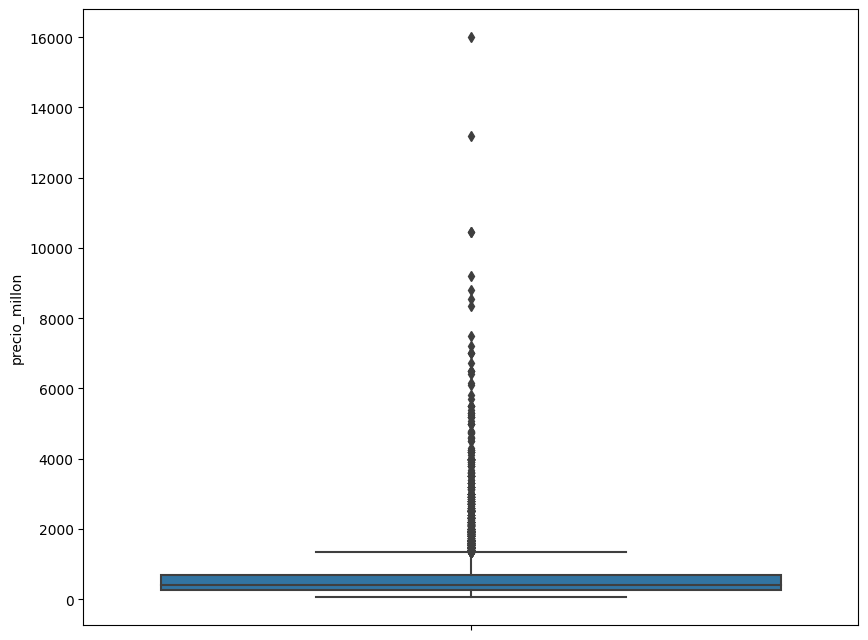

In [118]:
plt.figure(figsize=(10,8))
sns.boxplot(data=datos_ml, y = 'precio_millon')
plt.show()

In [120]:
datos_ml.query('precio_millon > 5000 | precio_millon < 60')

,Tipo,Descripcion,Habitaciones,Banos,Area,Barrio,UPZ,Valor,moneda,precio_millon,...,BARES_DISCO,RUIDO,OSCURO_PELIGROSO,SALARIO_MES,TIENE_ESCRITURA,PERDIDA_TRABAJO_C19,PERDIDA_INGRESOS_C19,PLANES_ADQUIRIR_VIVIENDA,NOMBRE_ESTRATO,COD_UPZ_GRUPO
207,Apartamento,Apartamento en venta en Chapinero,3,5,476,chapinero,CHAPINERO: Pardo Rubio + Chapinero,$ 8.550.000.000,$,8550.00,...,0.23,0.35,0.13,4034787.96,0.90,0.04,0.28,0.09,CHAPINERO: Pardo Rubio + Chapinero,816.00
323,Local,Local en venta en Chapinero,16,9,650,chapinero,CHAPINERO: Pardo Rubio + Chapinero,$ 5.800.000.000,$,5800.00,...,0.23,0.35,0.13,4034787.96,0.90,0.04,0.28,0.09,CHAPINERO: Pardo Rubio + Chapinero,816.00
702,Casa,Casa en venta en Chapinero,4,4,462,chapinero,CHAPINERO: Pardo Rubio + Chapinero,$ 5.200.000.000,$,5200.00,...,0.23,0.35,0.13,4034787.96,0.90,0.04,0.28,0.09,CHAPINERO: Pardo Rubio + Chapinero,816.00
708,Casa,Casa en venta en Chapinero,12,2,769,chapinero,CHAPINERO: Pardo Rubio + Chapinero,$ 6.160.000.000,$,6160.00,...,0.23,0.35,0.13,4034787.96,0.90,0.04,0.28,0.09,CHAPINERO: Pardo Rubio + Chapinero,816.00
829,Apartamento,Apartamento en venta en Zona Noroccidental,4,7,550,zona noroccidental,CHAPINERO: Pardo Rubio + Chapinero,$ 7.200.000.000,$,7200.00,...,0.23,0.35,0.13,4034787.96,0.90,0.04,0.28,0.09,CHAPINERO: Pardo Rubio + Chapinero,816.00
1371,Apartamento,Apartamento en venta en El Chicó,4,5,555,el chicó,CHAPINERO: Chicó Lago + El Refugio,$ 6.100.000.000,$,6100.00,...,0.05,0.19,0.02,5512355.76,0.88,0.03,0.19,0.07,CHAPINERO: Chicó Lago + El Refugio,817.00
1414,Apartamento,Apartamento en venta en El Chicó,3,5,1550,el chicó,CHAPINERO: Chicó Lago + El Refugio,$ 13.200.000.000,$,13200.00,...,0.05,0.19,0.02,5512355.76,0.88,0.03,0.19,0.07,CHAPINERO: Chicó Lago + El Refugio,817.00
1429,Local,Local en venta en Quinta Camacho,16,9,1050,quinta camacho,CHAPINERO: Chicó Lago + El Refugio,$ 5.299.999.744,$,5300.00,...,0.05,0.19,0.02,5512355.76,0.88,0.03,0.19,0.07,CHAPINERO: Chicó Lago + El Refugio,817.00
1442,Local,Local en venta en Quinta Camacho,16,9,1050,quinta camacho,CHAPINERO: Chicó Lago + El Refugio,$ 5.299.999.744,$,5300.00,...,0.05,0.19,0.02,5512355.76,0.88,0.03,0.19,0.07,CHAPINERO: Chicó Lago + El Refugio,817.00
1518,Apartamento,Apartamento en venta en Chico Reservado,4,5,378,chico reservado,CHAPINERO: Chicó Lago + El Refugio,$ 6.500.000.000,$,6500.00,...,0.05,0.19,0.02,5512355.76,0.88,0.03,0.19,0.07,CHAPINERO: Chicó Lago + El Refugio,817.00


In [121]:
datos_ml = datos_ml.query('precio_millon < 1200 & precio_millon > 60')
datos_ml

,Tipo,Descripcion,Habitaciones,Banos,Area,Barrio,UPZ,Valor,moneda,precio_millon,...,BARES_DISCO,RUIDO,OSCURO_PELIGROSO,SALARIO_MES,TIENE_ESCRITURA,PERDIDA_TRABAJO_C19,PERDIDA_INGRESOS_C19,PLANES_ADQUIRIR_VIVIENDA,NOMBRE_ESTRATO,COD_UPZ_GRUPO
0,Apartamento,Apartamento en venta en Zona Noroccidental,3,2,70,zona noroccidental,CHAPINERO: Pardo Rubio + Chapinero,$ 360.000.000,$,360.00,...,0.23,0.35,0.13,4034787.96,0.90,0.04,0.28,0.09,CHAPINERO: Pardo Rubio + Chapinero,816.00
1,Casa,Casa en venta en Marly,3,3,147,marly,CHAPINERO: Pardo Rubio + Chapinero,$ 300.000.000,$,300.00,...,0.23,0.35,0.13,4034787.96,0.90,0.04,0.28,0.09,CHAPINERO: Pardo Rubio + Chapinero,816.00
3,Apartamento,Apartamento en venta en Zona Noroccidental,2,1,45,zona noroccidental,CHAPINERO: Pardo Rubio + Chapinero,$ 239.000.000,$,239.00,...,0.23,0.35,0.13,4034787.96,0.90,0.04,0.28,0.09,CHAPINERO: Pardo Rubio + Chapinero,816.00
9,Casa,Casa en venta en Zona Noroccidental,5,2,200,zona noroccidental,CHAPINERO: Pardo Rubio + Chapinero,$ 580.000.000,$,580.00,...,0.23,0.35,0.13,4034787.96,0.90,0.04,0.28,0.09,CHAPINERO: Pardo Rubio + Chapinero,816.00
10,Apartamento,Apartamento en venta en Zona Noroccidental,3,2,78,zona noroccidental,CHAPINERO: Pardo Rubio + Chapinero,$ 278.000.000,$,278.00,...,0.23,0.35,0.13,4034787.96,0.90,0.04,0.28,0.09,CHAPINERO: Pardo Rubio + Chapinero,816.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9313,Apartamento,Apartamento en venta en Verbenal,2,2,48,verbenal,Verbenal,$ 250.000.000,$,250.00,...,0.03,0.25,0.14,2445403.14,0.87,0.03,0.27,0.09,Verbenal,9.00
9314,Apartamento,Apartamento en venta en Verbenal,2,1,38,verbenal,Verbenal,$ 180.000.000,$,180.00,...,0.03,0.25,0.14,2445403.14,0.87,0.03,0.27,0.09,Verbenal,9.00
9315,Apartamento,Apartamento en venta en Verbenal,2,1,38,verbenal,Verbenal,$ 180.000.000,$,180.00,...,0.03,0.25,0.14,2445403.14,0.87,0.03,0.27,0.09,Verbenal,9.00
9316,Apartamento,Apartamento en venta en Verbenal,2,1,48,verbenal,Verbenal,$ 240.000.000,$,240.00,...,0.03,0.25,0.14,2445403.14,0.87,0.03,0.27,0.09,Verbenal,9.00


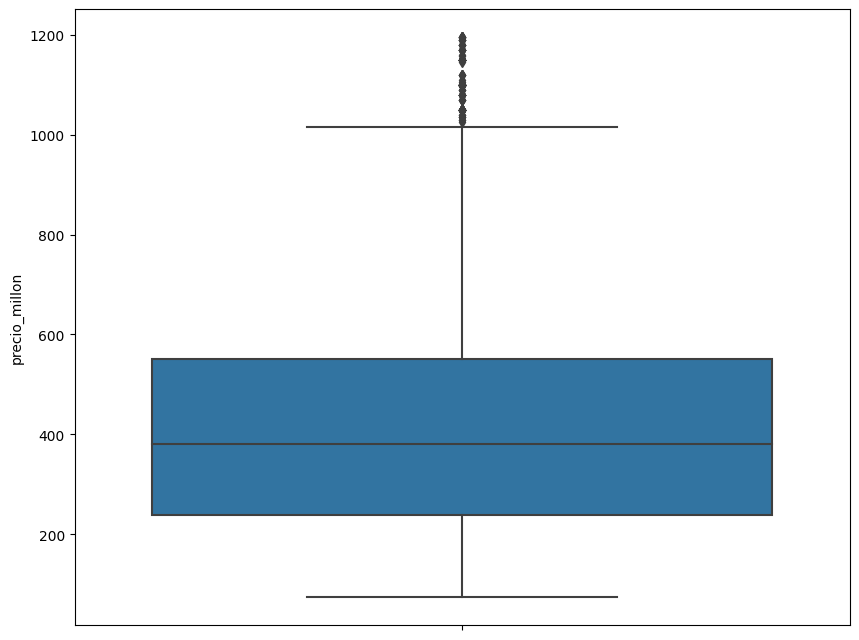

In [122]:
plt.figure(figsize=(10,8))
sns.boxplot(data=datos_ml, y = 'precio_millon')
plt.show()

In [123]:
datos_ml['SALARIO_ANUAL_MI'] = datos_ml['SALARIO_MES']*12/1000000
datos_ml['SALARIO_ANUAL_MI']

<ipython-input-123-71287e70a4cf>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



0      48.42
1      48.42
3      48.42
9      48.42
10     48.42
        ... 
9313   29.34
9314   29.34
9315   29.34
9316   29.34
9317   29.34
Name: SALARIO_ANUAL_MI, Length: 8313, dtype: float64

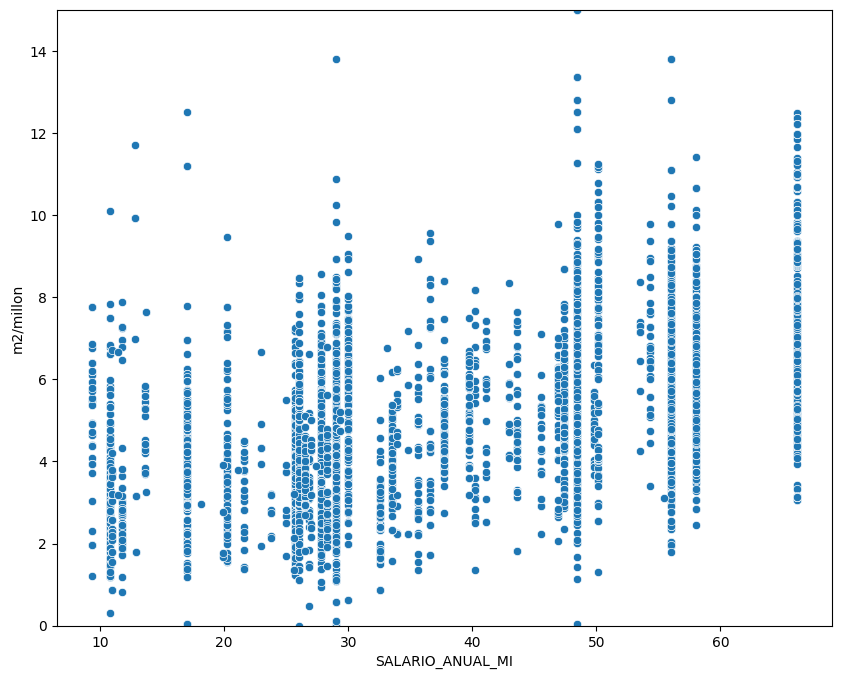

In [124]:
plt.figure(figsize=(10,8))
sns.scatterplot(data=datos_ml, x='SALARIO_ANUAL_MI',y ='m2/millon')
plt.ylim((0,15))
plt.show()

In [125]:
datos_ml.corr()

,Habitaciones,Banos,Area,precio_millon,m2/millon,Valor_m2_Barrio,CONJUNTO_CERRADO,INSEGURIDAD,TERMINALES_BUS,BARES_DISCO,RUIDO,OSCURO_PELIGROSO,SALARIO_MES,TIENE_ESCRITURA,PERDIDA_TRABAJO_C19,PERDIDA_INGRESOS_C19,PLANES_ADQUIRIR_VIVIENDA,COD_UPZ_GRUPO,SALARIO_ANUAL_MI
Habitaciones,1.00,0.44,0.03,0.18,-0.31,-0.21,-0.12,0.13,0.08,0.11,0.14,0.11,-0.17,-0.08,0.07,0.13,0.09,-0.12,-0.17
Banos,0.44,1.00,0.04,0.66,-0.03,0.13,0.16,-0.19,-0.17,-0.12,-0.17,-0.21,0.18,0.13,-0.09,-0.15,-0.08,0.01,0.18
Area,0.03,0.04,1.00,0.04,-0.04,-0.04,-0.01,-0.00,-0.01,-0.01,-0.00,0.01,-0.01,-0.01,0.02,0.01,0.01,-0.01,-0.01
precio_millon,0.18,0.66,0.04,1.00,0.36,0.40,0.32,-0.37,-0.28,-0.23,-0.35,-0.38,0.42,0.21,-0.17,-0.32,-0.18,0.17,0.42
m2/millon,-0.31,-0.03,-0.04,0.36,1.00,0.49,0.33,-0.37,-0.29,-0.22,-0.37,-0.35,0.46,0.23,-0.20,-0.36,-0.21,0.26,0.46
Valor_m2_Barrio,-0.21,0.13,-0.04,0.40,0.49,1.00,0.65,-0.66,-0.38,-0.41,-0.66,-0.60,0.82,0.41,-0.31,-0.65,-0.23,0.41,0.82
CONJUNTO_CERRADO,-0.12,0.16,-0.01,0.32,0.33,0.65,1.00,-0.84,-0.30,-0.51,-0.70,-0.67,0.81,0.61,-0.35,-0.78,0.05,0.08,0.81
INSEGURIDAD,0.13,-0.19,-0.00,-0.37,-0.37,-0.66,-0.84,1.00,0.51,0.60,0.85,0.75,-0.82,-0.56,0.29,0.74,0.09,0.00,-0.82
TERMINALES_BUS,0.08,-0.17,-0.01,-0.28,-0.29,-0.38,-0.30,0.51,1.00,0.39,0.67,0.57,-0.51,-0.30,0.17,0.36,0.25,-0.09,-0.51
BARES_DISCO,0.11,-0.12,-0.01,-0.23,-0.22,-0.41,-0.51,0.60,0.39,1.00,0.60,0.49,-0.38,-0.25,-0.02,0.33,-0.05,0.26,-0.38


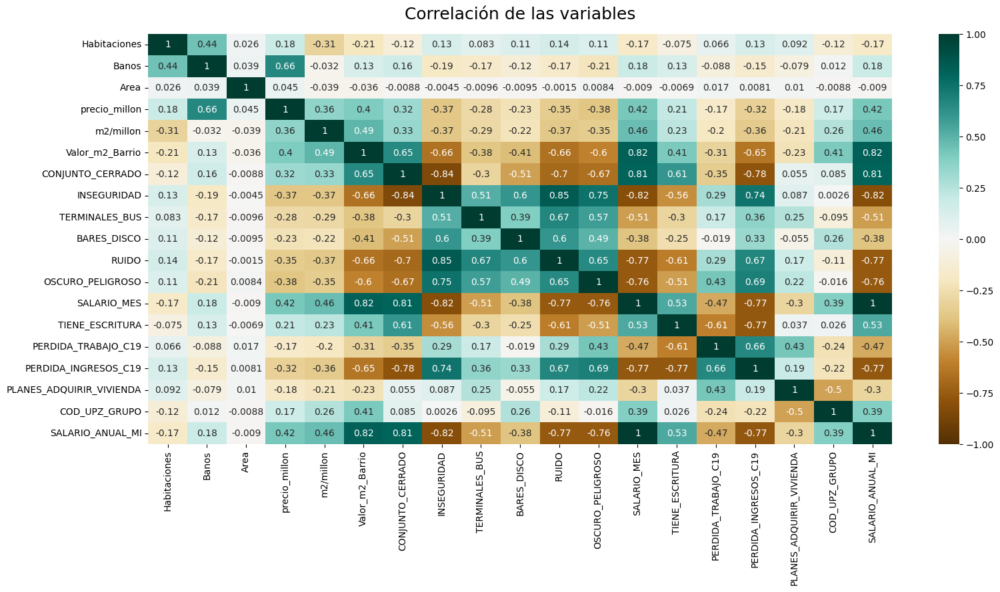

In [126]:
plt.figure(figsize=(18, 8))
#https://www.tylervigen.com/spurious-correlations
#mascara = np.triu(np.ones_like(datos_ml.corr(), dtype=bool)) mask=mascara,
heatmap = sns.heatmap(datos_ml.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlación de las variables', fontdict={'fontsize':18}, pad=16);

In [128]:
X = datos_ml[['COD_UPZ_GRUPO']]
y = datos_ml['precio_millon']

In [131]:
len(X)

8313

In [129]:
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.25,random_state=99)

In [130]:
X_train

,COD_UPZ_GRUPO
1512,817.00
7864,85.00
6058,21.00
1683,817.00
2481,14.00
...,...
6038,21.00
8875,102.00
2200,14.00
3883,803.00


In [132]:
X_test

,COD_UPZ_GRUPO
6340,74.00
7805,85.00
4902,47.00
7041,100.00
2436,14.00
...,...
3323,14.00
3945,803.00
5572,27.00
3633,803.00


In [133]:
y_train

1512   1050.00
7864    129.00
6058    206.38
1683    650.00
2481    250.00
         ...  
6038    560.00
8875    560.00
2200    685.00
3883    850.00
8154    132.00
Name: precio_millon, Length: 6234, dtype: float64

In [135]:
modelo = LinearRegression()

In [136]:
modelo.fit(X_train,y_train)

LinearRegression()

In [137]:
y_predict_test = modelo.predict(X_test)

In [139]:
baseline_mae = mean_absolute_error(y_test, y_predict_test)
baseline_r2 = r2_score(y_test, y_predict_test)
print(baseline_mae,baseline_r2)

187.323609443345 0.031111799984413713


In [140]:
datos_ml.head()

,Tipo,Descripcion,Habitaciones,Banos,Area,Barrio,UPZ,Valor,moneda,precio_millon,...,RUIDO,OSCURO_PELIGROSO,SALARIO_MES,TIENE_ESCRITURA,PERDIDA_TRABAJO_C19,PERDIDA_INGRESOS_C19,PLANES_ADQUIRIR_VIVIENDA,NOMBRE_ESTRATO,COD_UPZ_GRUPO,SALARIO_ANUAL_MI
0,Apartamento,Apartamento en venta en Zona Noroccidental,3,2,70,zona noroccidental,CHAPINERO: Pardo Rubio + Chapinero,$ 360.000.000,$,360.00,...,0.35,0.13,4034787.96,0.90,0.04,0.28,0.09,CHAPINERO: Pardo Rubio + Chapinero,816.00,48.42
1,Casa,Casa en venta en Marly,3,3,147,marly,CHAPINERO: Pardo Rubio + Chapinero,$ 300.000.000,$,300.00,...,0.35,0.13,4034787.96,0.90,0.04,0.28,0.09,CHAPINERO: Pardo Rubio + Chapinero,816.00,48.42
3,Apartamento,Apartamento en venta en Zona Noroccidental,2,1,45,zona noroccidental,CHAPINERO: Pardo Rubio + Chapinero,$ 239.000.000,$,239.00,...,0.35,0.13,4034787.96,0.90,0.04,0.28,0.09,CHAPINERO: Pardo Rubio + Chapinero,816.00,48.42
9,Casa,Casa en venta en Zona Noroccidental,5,2,200,zona noroccidental,CHAPINERO: Pardo Rubio + Chapinero,$ 580.000.000,$,580.00,...,0.35,0.13,4034787.96,0.90,0.04,0.28,0.09,CHAPINERO: Pardo Rubio + Chapinero,816.00,48.42
10,Apartamento,Apartamento en venta en Zona Noroccidental,3,2,78,zona noroccidental,CHAPINERO: Pardo Rubio + Chapinero,$ 278.000.000,$,278.00,...,0.35,0.13,4034787.96,0.90,0.04,0.28,0.09,CHAPINERO: Pardo Rubio + Chapinero,816.00,48.42


In [141]:
X = datos_ml[['COD_UPZ_GRUPO','Habitaciones','Banos','CONJUNTO_CERRADO','SALARIO_ANUAL_MI','TIENE_ESCRITURA']] 
y = datos_ml["precio_millon"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.25, random_state = 99)
modelo_1 = LinearRegression()
modelo_1.fit(X_train, y_train)
y_predict_test = modelo_1.predict(X_test)
y_predict_train = modelo_1.predict(X_train)
mae_test = mean_absolute_error(y_test, y_predict_test)
r2_test = r2_score(y_test, y_predict_test)
mae_train = mean_absolute_error(y_train, y_predict_train)
r2_train = r2_score(y_train, y_predict_train)
print(mae_test,r2_test)
print(mae_train,r2_train)

118.25967274431333 0.5404735562069192
123.22271988681676 0.5269614226488988


In [142]:
X = datos_ml[['COD_UPZ_GRUPO','Habitaciones','Banos','CONJUNTO_CERRADO','SALARIO_ANUAL_MI','TIENE_ESCRITURA']] 

y = datos_ml["precio_millon"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.25, random_state = 99)
modelo_1 = LinearRegression()
modelo_1.fit(X_train, y_train)
y_predict_test = modelo_1.predict(X_test)
y_predict_train = modelo_1.predict(X_train)
mae_test = mean_absolute_error(y_test, y_predict_test)
r2_test = r2_score(y_test, y_predict_test)
mae_train = mean_absolute_error(y_train, y_predict_train)
r2_train = r2_score(y_train, y_predict_train)
print(mae_test,r2_test)
print(mae_train,r2_train)
     

118.25967274431333 0.5404735562069192
123.22271988681676 0.5269614226488988


In [143]:
modelo_1.predict([[816,3,2,1,50,1]])

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:439: UserWarning:

X does not have valid feature names, but LinearRegression was fitted with feature names



array([434.21129691])